In [0]:
!nvidia-smi

Mon Jun 15 11:30:42 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.82       Driver Version: 440.82       CUDA Version: 10.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  GeForce GTX 106...  Off  | 00000000:01:00.0  On |                  N/A |
| N/A   56C    P0    24W /  N/A |    318MiB /  6075MiB |      2%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
pwd

'/home/joselmq/Documents'

# Step 2: Cloning and Building Darknet
The following cells will clone darknet from AlexeyAB's famous repository, adjust the Makefile to enable OPENCV and GPU for darknet and then build darknet.

Do not worry about any warnings when you run the '!make' cell!

In [0]:
# clone darknet repo
!git clone https://github.com/AlexeyAB/darknet
#!git clone https://github.com/pjreddie/darknet

Cloning into 'darknet'...
remote: Enumerating objects: 13524, done.
remote: Total 13524 (delta 0), reused 0 (delta 0), pack-reused 13524
Receiving objects: 100% (13524/13524), 12.17 MiB | 2.69 MiB/s, done.
Resolving deltas: 100% (9242/9242), done.


In [0]:
# change makefile to have GPU and OPENCV enabled
%cd darknet
!sed -i 's/OPENCV=0/OPENCV=1/' Makefile
!sed -i 's/GPU=0/GPU=1/' Makefile
!sed -i 's/CUDNN=0/CUDNN=1/' Makefile

/home/joselmq/Documents/darknet


In [0]:
# verify CUDA
!/usr/local/cuda/bin/nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2019 NVIDIA Corporation
Built on Sun_Jul_28_19:07:16_PDT_2019
Cuda compilation tools, release 10.1, V10.1.243


In [0]:
# make darknet (build)
!make

chmod +x *.sh
g++ -std=c++11 -std=c++11 -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/image_opencv.cpp -o obj/image_opencv.o
./src/image_opencv.cpp: In function ‘void draw_detections_cv_v3(void**, detection*, int, float, char**, image**, int, int)’:
./src/image_opencv.cpp:910:23: warning: variable ‘rgb’ set but not used [-Wunused-but-set-variable]
                 float rgb[3];
                       ^~~
./src/image_opencv.cpp: In function ‘void cv_draw_object(image, float*, int, int, int*, float*, int*, int, char**)’:
./src/image_opencv.cpp:1391:14: warning: unused variable ‘buff’ [-Wunused-variable]
         char buff[100];
              ^~~~
./src/image_opencv.cpp:1367:9: warning: unused variable ‘it_tb_res’ [-Wunused-variable]
     int it_tb_

gcc -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/convolutional_layer.c -o obj/convolutional_layer.o
./src/convolutional_layer.c: In function ‘forward_convolutional_layer’:
./src/convolutional_layer.c:1204:32: warning: unused variable ‘t_intput_size’ [-Wunused-variable]
                         size_t t_intput_size = binary_transpose_align_input(k, n, state.workspace, &l.t_bit_input, ldb_align, l.bit_align);
                                ^~~~~~~~~~~~~
gcc -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/list

gcc -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/connected_layer.c -o obj/connected_layer.o
./src/connected_layer.c: In function ‘forward_connected_layer_gpu’:
./src/connected_layer.c:346:11: warning: unused variable ‘one’ [-Wunused-variable]
     float one = 1;    // alpha[0], beta[0]
           ^~~
./src/connected_layer.c:344:13: warning: unused variable ‘c’ [-Wunused-variable]
     float * c = l.output_gpu;
             ^
./src/connected_layer.c:343:13: warning: unused variable ‘b’ [-Wunused-variable]
     float * b = l.weights_gpu;
             ^
./src/connected_layer.c:342:13: warning: unused variable ‘a’ [-Wunused-variable]
     float * a = state.input;
             ^
./src/connected_layer.c:341:9: warning: unused variable ‘n’ [-Wunused-va

./src/coco.c: In function ‘validate_coco_recall’:
./src/coco.c:248:11: warning: unused variable ‘base’ [-Wunused-variable]
     char *base = "results/comp4_det_test_";
           ^~~~
gcc -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/dice.c -o obj/dice.o
gcc -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/yolo.c -o obj/yolo.o
gcc -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno

gcc -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/gru_layer.c -o obj/gru_layer.o
gcc -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/rnn.c -o obj/rnn.o
gcc -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/rnn_vid.c -o obj/rnn_vid.o
gcc -Iinclude/ -I3rdparty/stb/include -DO

gcc -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/gaussian_yolo_layer.c -o obj/gaussian_yolo_layer.o
./src/gaussian_yolo_layer.c: In function ‘make_gaussian_yolo_layer’:
./src/gaussian_yolo_layer.c:71:38: warning: passing argument 1 of ‘cudaHostAlloc’ from incompatible pointer type [-Wincompatible-pointer-types]
     if (cudaSuccess == cudaHostAlloc(&l.output, batch*l.outputs * sizeof(float), cudaHostRegisterMapped)) l.output_pinned = 1;
                                      ^
In file included from /usr/local/cuda/include/cuda_runtime.h:96:0,
                 from include/darknet.h:41,
                 from ./src/gaussian_yolo_layer.h:5,
                 from ./src/gaussian_yolo_layer.c:7:
/usr/local/cuda/include/cuda_runtime_api.h:4391:39: note:

./src/im2col_kernels.cu:125:18: warning: "/*" within comment [-Wcomment]
                 //*data_col_ptr = (h >= 0 && w >= 0 && h < height && w < width) ?
                   
./src/im2col_kernels.cu:1178:6: warning: "/*" within comment [-Wcomment]
     //*((uint64_t *)(A_s + (local_i*lda + k) / 8)) = *((uint64_t *)(A + (i_cur*lda + k) / 8));    // weights
       
./src/im2col_kernels.cu:125:18: warning: "/*" within comment [-Wcomment]
                 //*data_col_ptr = (h >= 0 && w >= 0 && h < height && w < width) ?
                   
./src/im2col_kernels.cu:1178:6: warning: "/*" within comment [-Wcomment]
     //*((uint64_t *)(A_s + (local_i*lda + k) / 8)) = *((uint64_t *)(A + (i_cur*lda + k) / 8));    // weights
       
./src/im2col_kernels.cu:125:18: warning: "/*" within comment [-Wcomment]
                 //*data_col_ptr = (h >= 0 && w >= 0 && h < height && w < width) ?
                   
./src/im2col_kernels.cu:1178:6: warning: "/*" within comment [-Wcomment]
     //*((uint64_

nvcc -gencode arch=compute_30,code=sm_30 -gencode arch=compute_35,code=sm_35 -gencode arch=compute_50,code=[sm_50,compute_50] -gencode arch=compute_52,code=[sm_52,compute_52] -gencode arch=compute_61,code=[sm_61,compute_61] -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN --compiler-options "-Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include" -c ./src/maxpool_layer_kernels.cu -o obj/maxpool_layer_kernels.o
nvcc -gencode arch=compute_30,code=sm_30 -gencode arch=compute_35,code=sm_35 -gencode arch=compute_50,code=[sm_50,compute_50] -gencode arch=compute_52,code=[sm_52,compute_52] -gencode arch=compute_61,code=[sm_61,compute_61] -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN --compiler-options "-Wall -W

# Get CIFAR10 The Data

In [0]:
%cd data
!wget https://pjreddie.com/media/files/cifar.tgz
!tar xzf cifar.tgz
%cd ..

/home/joselmq/Documents/darknet/data
--2020-05-25 08:18:55--  https://pjreddie.com/media/files/cifar.tgz
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 168584360 (161M) [application/octet-stream]
Saving to: ‘cifar.tgz’

cifar.tgz           100%[===================>] 160,77M   171KB/s    in 20m 20s 

2020-05-25 08:39:16 (135 KB/s) - ‘cifar.tgz’ saved [168584360/168584360]

/home/joselmq/Documents/darknet


# CIFAR10's labels 

In [0]:
!cat data/cifar/labels.txt

airplane
automobile
bird
cat
deer
dog
frog
horse
ship
truck


In [0]:
%cd data/cifar
!ls
%cd ../..

/home/joselmq/Documents/darknet/data/cifar
labels.txt  test  train
/home/joselmq/Documents/darknet


## Txt Generation

YOLO expect a file with the bounding boxes showing where is the object in the image and where. Since CIFAR is a data set with the crop centered on the object and for simplicity, I use bounding boxes using all the image (0.5 -> half x and y; 1 -> all wide and hight). The label is given in the image's name.

In [0]:
!pwd

/home/joselmq/Documents/darknet


In [0]:
import os, shutil, re

test_directory = "/home/joselmq/Documents/darknet/data/cifar/test"
train_directory = "/home/joselmq/Documents/darknet/data/cifar/train"
labels = {"airplane":0,
        "automobile":1,
        "bird":2,
        "cat":3,
        "deer":4,
        "dog":5,
        "frog":6,
        "horse":7,
        "ship":8,
        "truck":9 }

def GenerateTxt(directory):
    for filename in os.listdir(directory):
        new_filename = filename.split(".")
        new_filename = new_filename[0] + ".txt"
        file_label = re.split("[_ .]", filename)
        file_label = file_label[1]

        f = open(new_filename, "w+")
        f.write(f"{labels[file_label]} 0.5 0.5 1 1")
        f.close()

In [0]:
%cd data/cifar/test
GenerateTxt(test_directory)



/home/joselmq/Documents/darknet/data/cifar/test


In [0]:
%cd ../train
GenerateTxt(train_directory)

/home/joselmq/Documents/darknet/data/cifar/train


In [0]:
%cd ../../..

/home/joselmq/Documents/darknet


# train.list and test.list

In [0]:
%cd data/cifar
!find `pwd`/train -name \*.png > train.list
!find `pwd`/test -name \*.png > test.list
%cd ../..

/home/joselmq/Documents/darknet/data/cifar
/home/joselmq/Documents/darknet


# cfg/cifar.data
# Contenido cfg/cifar_small.cfg


<details><summary>Show file content</summary>
<p>

```
[net]
batch=128
subdivisions=1
height=28
width=28
channels=3
max_crop=32
min_crop=32

hue=.1
saturation=.75
exposure=.75

learning_rate=0.1
policy=poly
power=4
max_batches = 5000
momentum=0.9
decay=0.0005

[convolutional]
batch_normalize=1
filters=32
size=3
stride=1
pad=1
activation=leaky

[maxpool]
size=2
stride=2

[convolutional]
batch_normalize=1
filters=16
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=64
size=3
stride=1
pad=1
activation=leaky

[maxpool]
size=2
stride=2

[convolutional]
batch_normalize=1
filters=32
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=128
size=3
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=64
size=1
stride=1
pad=1
activation=leaky

[convolutional]
filters=10
size=1
stride=1
pad=1
activation=leaky

[avgpool]

[softmax]
```

</p>
</details>

# Contenido cfg/yolov3_custom.cfg


<details><summary>Show file content</summary>
<p>

```
[net]
# Testing
# batch=1
# subdivisions=1
# Training
batch=64
subdivisions=16
height=32
width=32
channels=3
momentum=0.9
decay=0.0005
angle=0
hue=.1
saturation=.75
exposure=.75
max_crop=32
min_crop=32

learning_rate=0.001
burn_in=1000
max_batches = 50000
policy=steps
steps= 40000,45000
scales=.1,.1

[convolutional]
batch_normalize=1
filters=32
size=3
stride=1
pad=1
activation=leaky

# Downsample

[convolutional]
batch_normalize=1
filters=64
size=3
stride=2
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=32
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=64
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

# Downsample

[convolutional]
batch_normalize=1
filters=128
size=3
stride=2
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=64
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=128
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=64
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=128
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

# Downsample

[convolutional]
batch_normalize=1
filters=256
size=3
stride=2
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

# Downsample

[convolutional]
batch_normalize=1
filters=512
size=3
stride=2
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

# Downsample

[convolutional]
batch_normalize=1
filters=1024
size=3
stride=2
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=1024
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=1024
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=1024
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=1024
size=3
stride=1
pad=1
activation=leaky

[shortcut]
from=-3
activation=linear
#stopbackward=1

######################

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=1024
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=1024
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=1024
activation=leaky

[convolutional]
size=1
stride=1
pad=1
filters=45
activation=linear


[yolo]
mask = 6,7,8
anchors = 10,13,  16,30,  33,23,  30,61,  62,45,  59,119,  116,90,  156,198,  373,326
classes=10
num=9
jitter=.3
ignore_thresh = .7
truth_thresh = 1
random=1


[route]
layers = -4

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[upsample]
stride=2

[route]
layers = -1, 61



[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=512
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=512
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=512
activation=leaky

[convolutional]
size=1
stride=1
pad=1
filters=45
activation=linear


[yolo]
mask = 3,4,5
anchors = 10,13,  16,30,  33,23,  30,61,  62,45,  59,119,  116,90,  156,198,  373,326
classes=10
num=9
jitter=.3
ignore_thresh = .7
truth_thresh = 1
random=1



[route]
layers = -4

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[upsample]
stride=2

[route]
layers = -1, 36



[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=256
activation=leaky

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=256
activation=leaky

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=256
activation=leaky

[convolutional]
size=1
stride=1
pad=1
filters=45
activation=linear


[yolo]
mask = 0,1,2
anchors = 10,13,  16,30,  33,23,  30,61,  62,45,  59,119,  116,90,  156,198,  373,326
classes=10
num=9
jitter=.3
ignore_thresh = .7
truth_thresh = 1
random=1

```
</p>
</details>


# Step 3: Download pretrained YOLOv3 weights
YOLOv3 has been trained already on the coco dataset which has 80 classes that it can predict. We will grab these pretrained weights so that we can run YOLOv3 on these pretrained classes and get detections.

In [0]:
# get yolov3 pretrained coco dataset weights
!wget https://pjreddie.com/media/files/yolov3.weights

--2020-05-25 08:53:31--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘yolov3.weights’

yolov3.weights      100%[===================>] 236,52M   147KB/s    in 20m 39s 

2020-05-25 09:14:12 (195 KB/s) - ‘yolov3.weights’ saved [248007048/248007048]



In [0]:
# define helper functions
def imShow(path):
  import cv2
  import matplotlib.pyplot as plt
  %matplotlib inline

  image = cv2.imread(path)
  height, width = image.shape[:2]
  resized_image = cv2.resize(image,(3*width, 3*height), interpolation = cv2.INTER_CUBIC)

  fig = plt.gcf()
  fig.set_size_inches(18, 10)
  plt.axis("off")
  plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
  plt.show()

# use this to upload files
def upload():
  from google.colab import files
  uploaded = files.upload() 
  for name, data in uploaded.items():
    with open(name, 'wb') as f:
      f.write(data)
      print ('saved file', name)

# use this to download a file  
def download(path):
  from google.colab import files
  files.download(path)

# Step 4: Run Detections with Darknet and YOLOv3!
Darknet is now built and ready to run detections using YOLOv3 in the cloud! You can find out which sorts of classes the pretrained YOLOv3 weights can detect by clicking here. [COCO CLASSES](http://cocodataset.org/#explore)

The object detector can be run using the following command
```bash
!./darknet detect <path to config> <path to weights> <path to image>
```
Darknet comes with a few images already installed in the darknet/data/ folder.

**Note:** After running detections OpenCV can't open the image instantly in the cloud so we must run: 
```bash
imShow('predictions.jpg')
```
This will output the image with the detections shown. The most recent detections are always saved to 'predictions.jpg'

Try out the examples below for yourself!

In [0]:
# run darknet detection
!./darknet detect cfg/yolov3.cfg yolov3.weights data/person.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

Done! Loaded 107 layers from weights-file 
data/person.jpg: Predicted in 42.793000 milli-seconds.
dog: 99%
person: 100%
horse: 100%


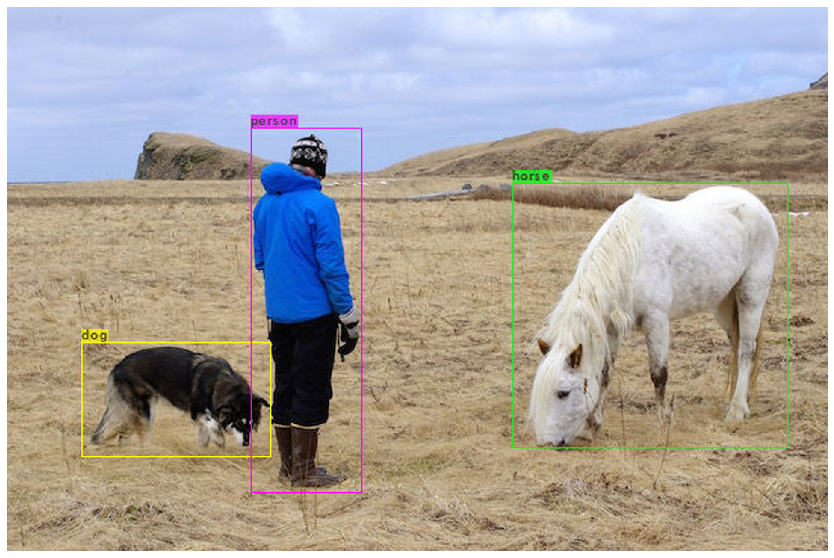

In [0]:
# show image using our helper function
imShow('predictions.jpg')

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

Done! Loaded 107 layers from weights-file 
data/dog.jpg: Predicted in 44.129000 milli-seconds.
bicycle: 99%
dog: 100%
truck: 94%


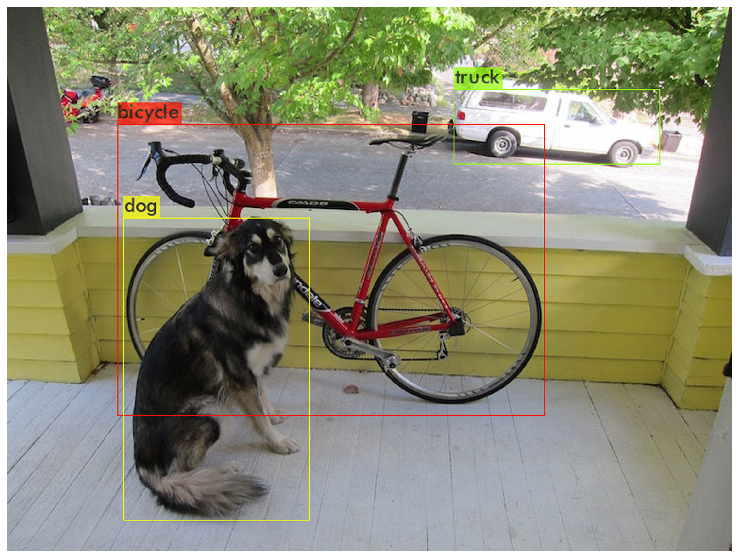

In [0]:
# look we can run another detection!
!./darknet detect cfg/yolov3.cfg yolov3.weights data/dog.jpg
imShow('predictions.jpg')

 WOW this is magic! Make sure to click this link to be blessed with lots of YOLOv3 luck!!!
 [https://www.youtube.com/channel/UCrydcKaojc44XnuXrfhlV8Q?sub_confirmation=1](https://www.youtube.com/channel/UCrydcKaojc44XnuXrfhlV8Q?sub_confirmation=1)

In [0]:
# run darknet command with google drive image (my image path is /images/plane.jpg)
# %cd darknet
!./darknet detect cfg/yolov3.cfg yolov3.weights data/Agata-barco.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-barco.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

 105 conv    255       1 x 1/ 1     52 x  52 x 256 ->   52 x  52 x 255 0.353 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 65.879 
avg_outputs = 532444 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from yolov3.weights...
 seen 64, trained: 32013 K-images (500 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/Agata-barco.jpg: Predicted in 43.236000 milli-seconds.
dog: 100%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/Agata-carpa.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-carpa.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

 104 conv    256       3 x 3/ 1     52 x  52 x 128 ->   52 x  52 x 256 1.595 BF
 105 conv    255       1 x 1/ 1     52 x  52 x 256 ->   52 x  52 x 255 0.353 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 65.879 
avg_outputs = 532444 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from yolov3.weights...
 seen 64, trained: 32013 K-images (500 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/Agata-carpa.jpg: Predicted in 42.596000 milli-seconds.
dog: 99%
dog: 100%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/Agata-ojo.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-ojo.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 65.879 
avg_outputs = 532444 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from yolov3.weights...
 seen 64, trained: 32013 K-images (500 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/Agata-ojo.jpg: Predicted in 43.080000 milli-seconds.
horse: 36%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/arbusto.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/arbusto.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

Done! Loaded 107 layers from weights-file 
data/arbusto.jpg: Predicted in 40.696000 milli-seconds.
bear: 83%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/arbusto-2.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/arbusto-2.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

Done! Loaded 107 layers from weights-file 
data/arbusto-2.jpg: Predicted in 42.875000 milli-seconds.
cow: 38%
horse: 36%
person: 25%
person: 31%
person: 39%
person: 52%
person: 26%
person: 40%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/ave.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/ave.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

 105 conv    255       1 x 1/ 1     52 x  52 x 256 ->   52 x  52 x 255 0.353 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 65.879 
avg_outputs = 532444 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from yolov3.weights...
 seen 64, trained: 32013 K-images (500 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/ave.jpg: Predicted in 42.569000 milli-seconds.
bird: 100%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/cisne-pez.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/cisne-pez.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

 102 conv    256       3 x 3/ 1     52 x  52 x 128 ->   52 x  52 x 256 1.595 BF
 103 conv    128       1 x 1/ 1     52 x  52 x 256 ->   52 x  52 x 128 0.177 BF
 104 conv    256       3 x 3/ 1     52 x  52 x 128 ->   52 x  52 x 256 1.595 BF
 105 conv    255       1 x 1/ 1     52 x  52 x 256 ->   52 x  52 x 255 0.353 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 65.879 
avg_outputs = 532444 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from yolov3.weights...
 seen 64, trained: 32013 K-images (500 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/cisne-pez.jpg: Predicted in 42.555000 milli-seconds.
bird: 100%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/estrella-de-mar.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/estrella-de-mar.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

Done! Loaded 107 layers from weights-file 
data/estrella-de-mar.jpg: Predicted in 43.270000 milli-seconds.


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/flamencos.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/flamencos.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

 105 conv    255       1 x 1/ 1     52 x  52 x 256 ->   52 x  52 x 255 0.353 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 65.879 
avg_outputs = 532444 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from yolov3.weights...
 seen 64, trained: 32013 K-images (500 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/flamencos.jpg: Predicted in 43.037000 milli-seconds.
person: 93%
bird: 92%
bird: 96%
bird: 57%
bird: 87%
bird: 74%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/foca.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/foca.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

 Allocate additional workspace_size = 52.43 MB 
Loading weights from yolov3.weights...
 seen 64, trained: 32013 K-images (500 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/foca.jpg: Predicted in 43.565000 milli-seconds.
dog: 44%
bird: 26%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/gato.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/gato.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

Loading weights from yolov3.weights...
 seen 64, trained: 32013 K-images (500 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/gato.jpg: Predicted in 42.558000 milli-seconds.


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/gente-lejana.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/gente-lejana.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

 104 conv    256       3 x 3/ 1     52 x  52 x 128 ->   52 x  52 x 256 1.595 BF
 105 conv    255       1 x 1/ 1     52 x  52 x 256 ->   52 x  52 x 255 0.353 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 65.879 
avg_outputs = 532444 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from yolov3.weights...
 seen 64, trained: 32013 K-images (500 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/gente-lejana.jpg: Predicted in 42.908000 milli-seconds.
person: 82%
person: 48%
person: 58%
person: 27%
person: 26%
person: 59%
person: 72%
person: 85%
person: 32%
person: 79%
person: 28%
person: 56%
person: 95%
person: 75%
backpack: 46%
person: 43%
person: 47%
backpack: 38%
person: 93%
person: 95%
person: 98%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/gorrion.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/gorrion.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

 105 conv    255       1 x 1/ 1     52 x  52 x 256 ->   52 x  52 x 255 0.353 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 65.879 
avg_outputs = 532444 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from yolov3.weights...
 seen 64, trained: 32013 K-images (500 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/gorrion.jpg: Predicted in 39.293000 milli-seconds.
bird: 54%
bird: 100%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/perras-juntas.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/perras-juntas.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

 102 conv    256       3 x 3/ 1     52 x  52 x 128 ->   52 x  52 x 256 1.595 BF
 103 conv    128       1 x 1/ 1     52 x  52 x 256 ->   52 x  52 x 128 0.177 BF
 104 conv    256       3 x 3/ 1     52 x  52 x 128 ->   52 x  52 x 256 1.595 BF
 105 conv    255       1 x 1/ 1     52 x  52 x 256 ->   52 x  52 x 255 0.353 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 65.879 
avg_outputs = 532444 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from yolov3.weights...
 seen 64, trained: 32013 K-images (500 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/perras-juntas.jpg: Predicted in 43.188000 milli-seconds.
dog: 95%
cat: 78%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/perras-juntas-2.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/perras-juntas-2.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

 104 conv    256       3 x 3/ 1     52 x  52 x 128 ->   52 x  52 x 256 1.595 BF
 105 conv    255       1 x 1/ 1     52 x  52 x 256 ->   52 x  52 x 255 0.353 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 65.879 
avg_outputs = 532444 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from yolov3.weights...
 seen 64, trained: 32013 K-images (500 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/perras-juntas-2.jpg: Predicted in 42.769000 milli-seconds.
dog: 99%


In [0]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/rana-camuflada.jpg
#imShow('predictions.jpg')
!cp predictions.jpg backup/rana-camuflada.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, output

Done! Loaded 107 layers from weights-file 
data/rana-camuflada.jpg: Predicted in 46.903000 milli-seconds.


# Step 4: Download pre-trained weights for the convolutional layers.
This step downloads the weights for the convolutional layers of the YOLOv3 network. By using these weights it helps your custom object detector to be way more accurate and not have to train as long. You don't have to use these weights but trust me it will help your modle converge and be accurate way faster. USE IT!

In [0]:
# upload pretrained convolutional layer weights
!wget http://pjreddie.com/media/files/darknet53.conv.74

URL transformed to HTTPS due to an HSTS policy
--2020-05-25 09:15:28--  https://pjreddie.com/media/files/darknet53.conv.74
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 162482580 (155M) [application/octet-stream]
Saving to: ‘darknet53.conv.74’

darknet53.conv.74   100%[===================>] 154,96M   205KB/s    in 18m 47s 

2020-05-25 09:34:18 (141 KB/s) - ‘darknet53.conv.74’ saved [162482580/162482580]



# Training

In [0]:
!./darknet detector train cfg/cifar.data cfg/yolov3_custom.cfg darknet53.conv.74 -map

You can observe a chart of how your model did throughout the training process by running the below command. It shows a chart of your average loss vs. iterations. For your model to be 'accurate' you would aim for a loss under 2.

**TRICK**: If for some reason you get an error or your Colab goes idle during training, you have not lost your weights! Every 100 iterations a weights file called **yolov3_custom_last.weights** is saved to **mydrive/yolov3/backup/** folder (wherever your backup folder is). This is why we created this folder in our Google drive and not on the cloud VM. If your runtime crashes and your backup folder was in your cloud VM you would lose your weights and your training progress.

We can kick off training from our last saved weights file so that we don't have to restart! WOOHOO! Just run the following command but with your backup location.
```
!./darknet detector train data/obj.data cfg/yolov3_custom.cfg /mydrive/yolov3/backup/yolov3_custom_last.weights -dont_show
```

In [0]:
!./darknet detector train data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights -dont_show

In [0]:
!./darknet detector train data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights -dont_show

In [0]:
imShow('chart.png')

# Step 6: Run Your Custom Object Detector!!!
You have done it! You now have a custom object detector to make your very own detections. Time to test it out and have some fun!

In [0]:
# need to set our custom cfg to test mode 
%cd cfg
!sed -i 's/batch=64/batch=1/' yolov3_custom.cfg
!sed -i 's/subdivisions=16/subdivisions=1/' yolov3_custom.cfg
%cd ..


/home/joselmq/Documents/darknet/cfg
/home/joselmq/Documents/darknet


### Small image generator

In [0]:
import cv2
Width = 32
Height = 32
Dimension = (Width, Height)

path = r'data/gorrion.jpg'
image = cv2.imread(path) 
filename = r'data/gorrion_small.jpg'

ImgResized = cv2.resize(image, Dimension, interpolation = cv2.INTER_AREA)
cv2.imwrite(filename, ImgResized) 

True

# For Ubuntu

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/person.jpg: Predicted in 14.311000 milli-seconds.
horse: 39%


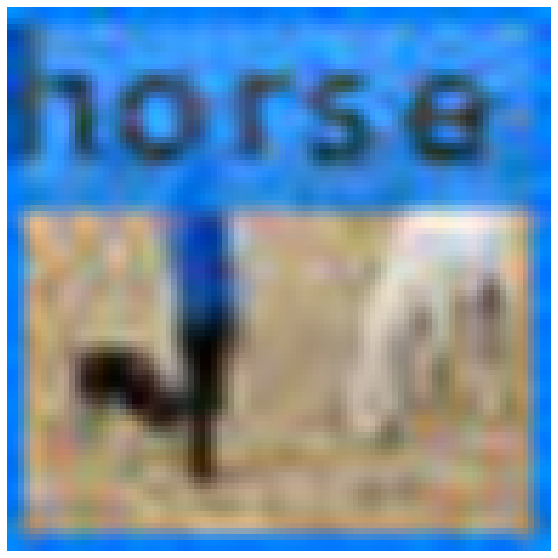

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_40000.weights data/person.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/person_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_41000.weights...
 seen 64, trained: 2624 K-images (41 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/person.jpg: Predicted in 15.674000 milli-seconds.
horse: 59%
bird: 45%


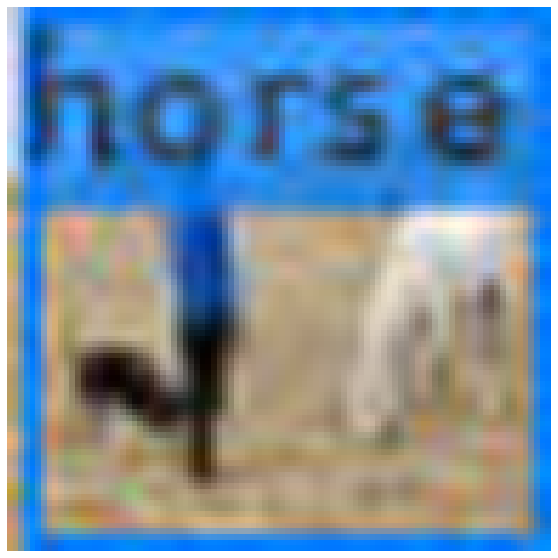

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_41000.weights data/person.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/person_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 100 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 101 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_42000.weights...
 seen 64, trained: 2688 K-images (42 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/person.jpg: Predicted in 14.348000 milli-seconds.
horse: 73%
bird: 34%


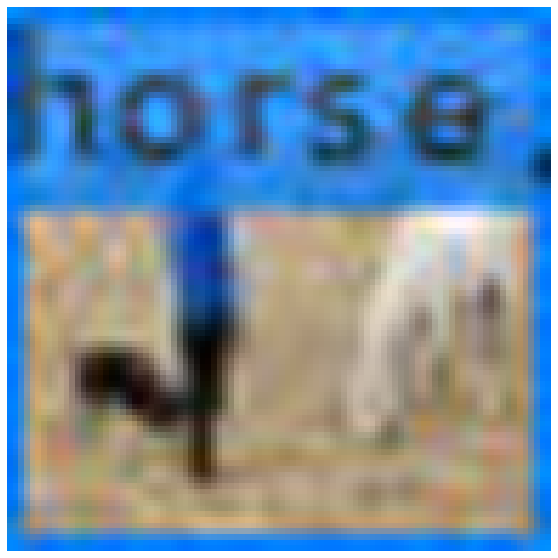

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_42000.weights data/person.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/person_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/person.jpg: Predicted in 15.795000 milli-seconds.
horse: 38%


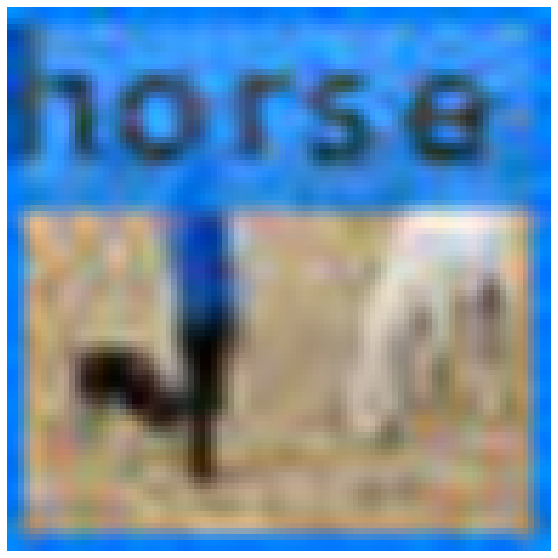

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_43000.weights data/person.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/person_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/person.jpg: Predicted in 14.958000 milli-seconds.
bird: 64%
horse: 43%


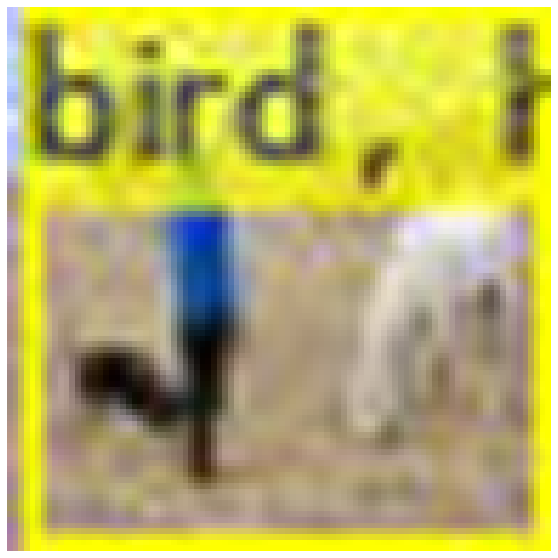

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_44000.weights data/person.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/person_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_45000.weights...
 seen 64, trained: 2880 K-images (45 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/person.jpg: Predicted in 15.540000 milli-seconds.


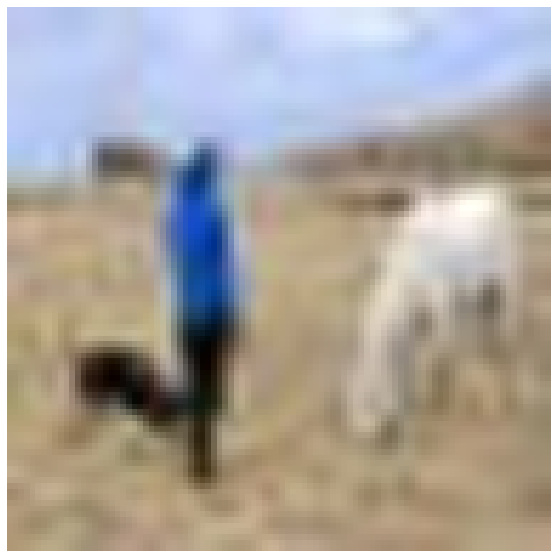

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_45000.weights data/person.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/person_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/person.jpg: Predicted in 16.050000 milli-seconds.
horse: 48%
bird: 40%


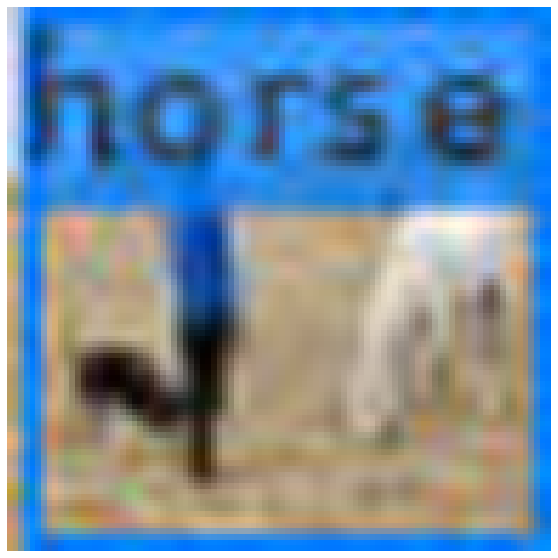

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_46000.weights data/person.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/person_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/person.jpg: Predicted in 14.324000 milli-seconds.
bird: 60%
horse: 48%


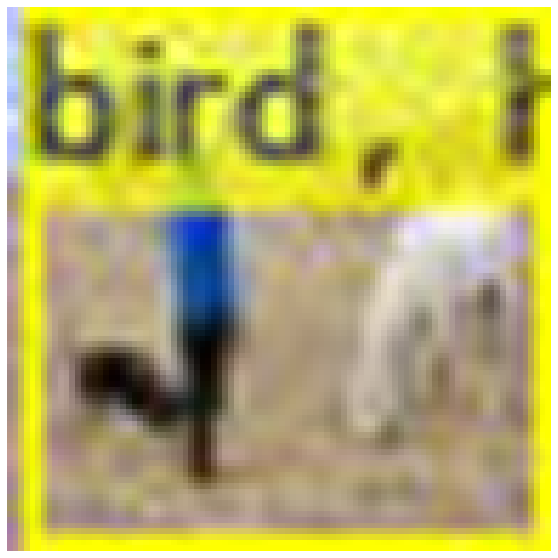

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_47000.weights data/person.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/person_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 100 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 101 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_48000.weights...
 seen 64, trained: 3072 K-images (48 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/person.jpg: Predicted in 15.010000 milli-seconds.
bird: 61%
horse: 46%


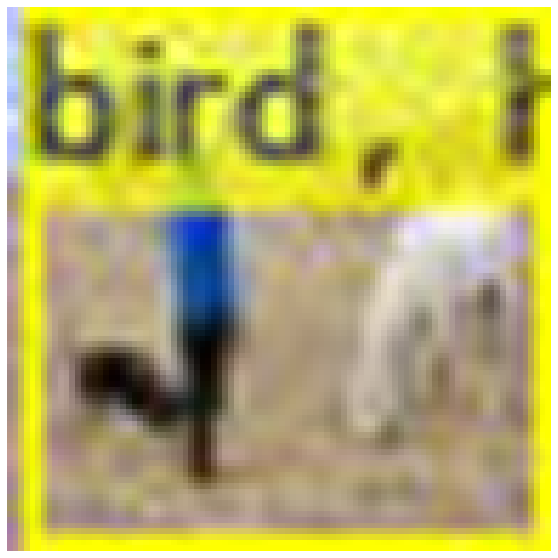

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_48000.weights data/person.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/person_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/person.jpg: Predicted in 15.600000 milli-seconds.
horse: 45%
bird: 36%


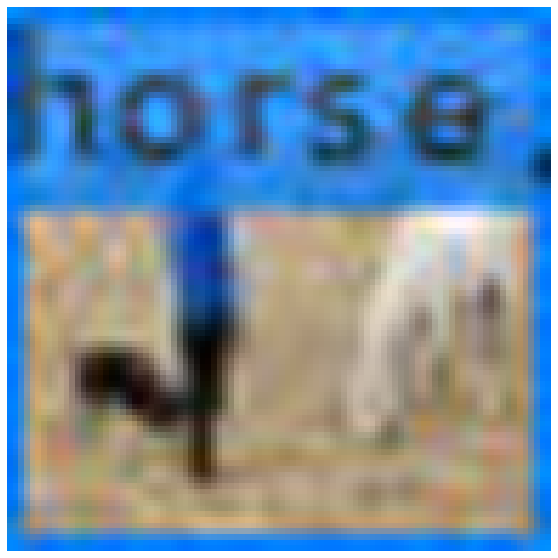

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_49000.weights data/person.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/person_new.jpg

### dog

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_40000.weights...
 seen 64, trained: 2560 K-images (40 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/dog_small.jpg: Predicted in 14.317000 milli-seconds.
truck: 41%
cat: 38%


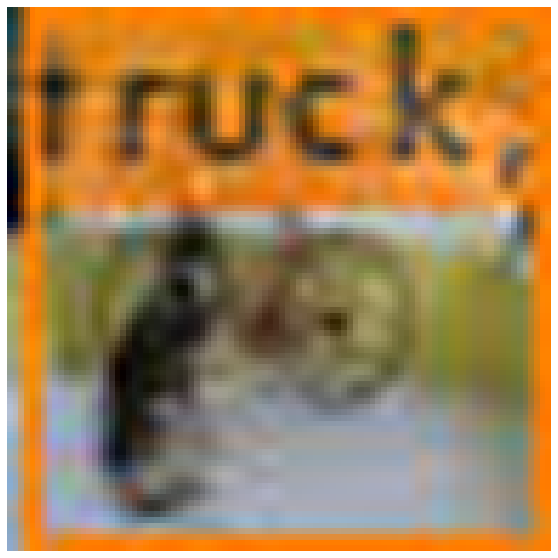

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_40000.weights data/dog_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/dog_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/dog_small.jpg: Predicted in 14.610000 milli-seconds.
cat: 67%
truck: 40%


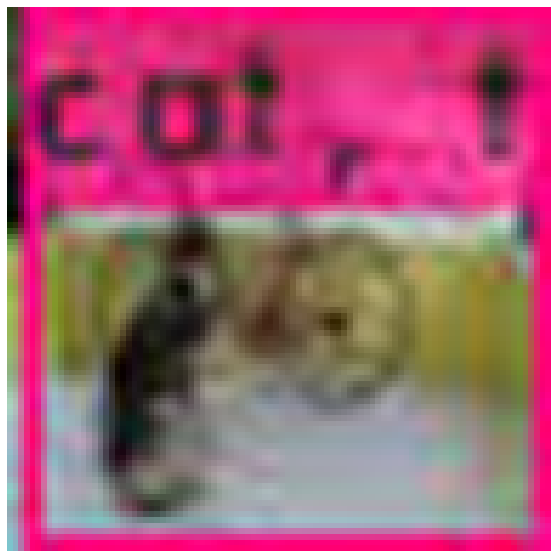

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_41000.weights data/dog_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/dog_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/dog_small.jpg: Predicted in 14.744000 milli-seconds.
cat: 67%


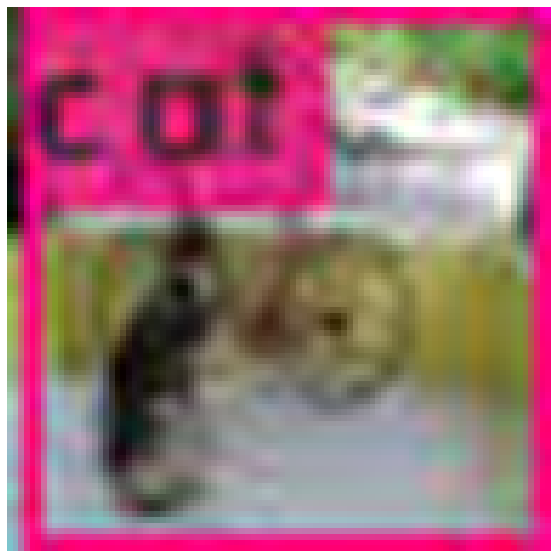

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_42000.weights data/dog_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/dog_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/dog_small.jpg: Predicted in 14.336000 milli-seconds.
cat: 35%


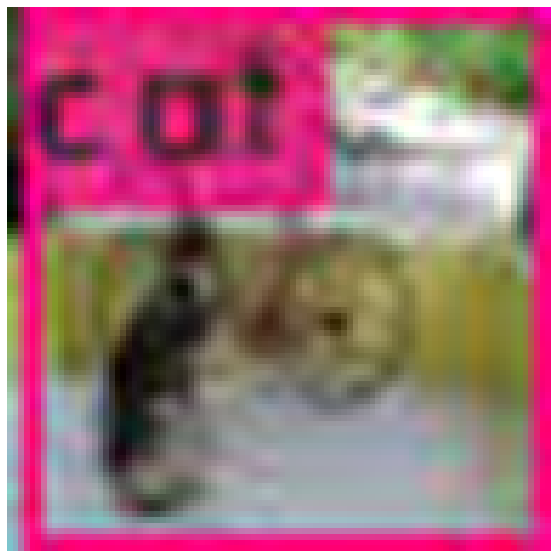

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_43000.weights data/dog_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/dog_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/dog_small.jpg: Predicted in 15.669000 milli-seconds.
cat: 74%


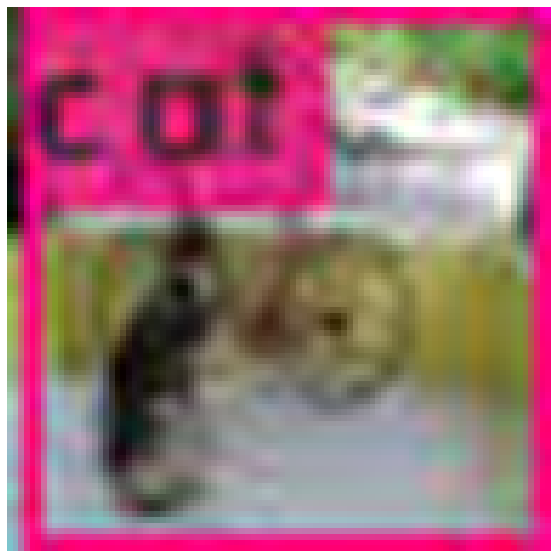

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_44000.weights data/dog_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/dog_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_45000.weights...
 seen 64, trained: 2880 K-images (45 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/dog_small.jpg: Predicted in 15.732000 milli-seconds.
cat: 38%


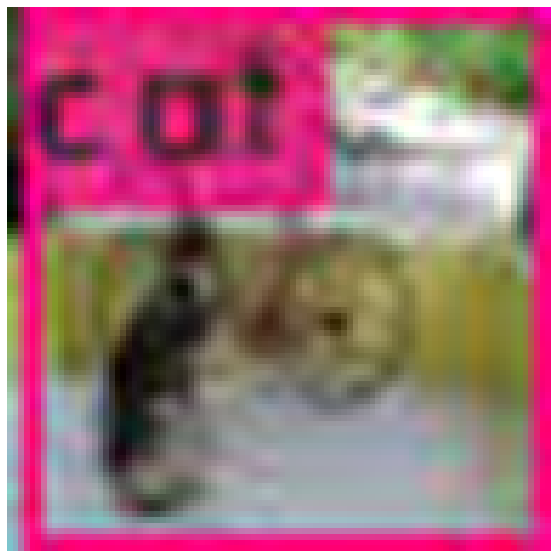

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_45000.weights data/dog_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/dog_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 100 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 101 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_46000.weights...
 seen 64, trained: 2944 K-images (46 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/dog_small.jpg: Predicted in 14.319000 milli-seconds.
cat: 58%


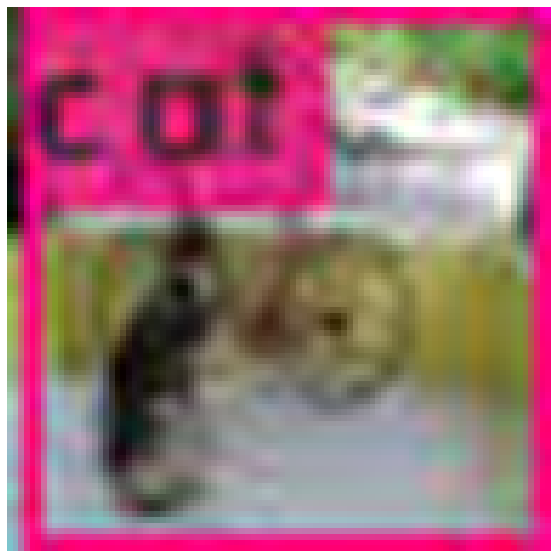

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_46000.weights data/dog_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/dog_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_47000.weights...
 seen 64, trained: 3008 K-images (47 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/dog_small.jpg: Predicted in 14.334000 milli-seconds.
cat: 77%


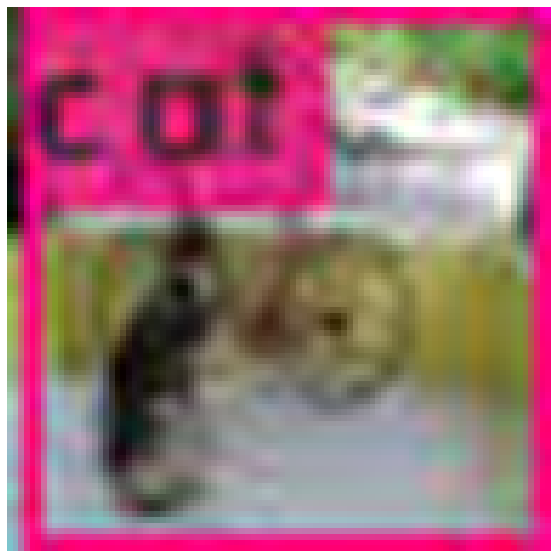

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_47000.weights data/dog_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/dog_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_48000.weights...
 seen 64, trained: 3072 K-images (48 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/dog_small.jpg: Predicted in 15.772000 milli-seconds.
cat: 79%


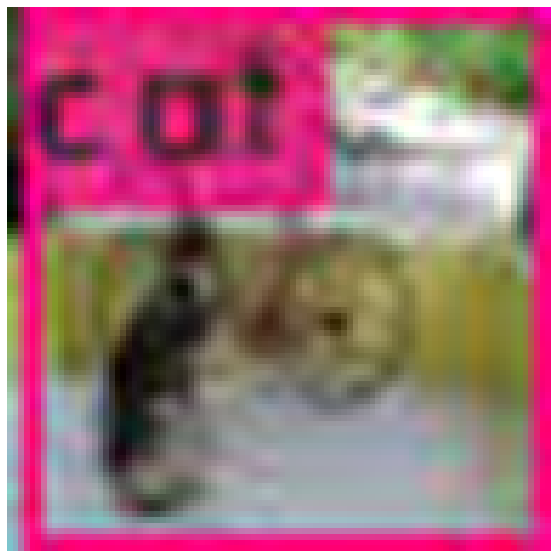

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_48000.weights data/dog_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/dog_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_49000.weights...
 seen 64, trained: 3136 K-images (49 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/dog_small.jpg: Predicted in 14.421000 milli-seconds.
cat: 57%


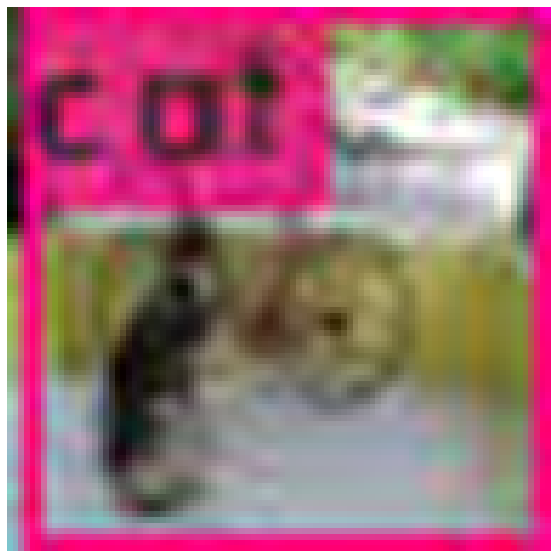

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_49000.weights data/dog_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/dog_new.jpg

### horse

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 100 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 101 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_40000.weights...
 seen 64, trained: 2560 K-images (40 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/horses_small.jpg: Predicted in 14.284000 milli-seconds.
airplane: 57%


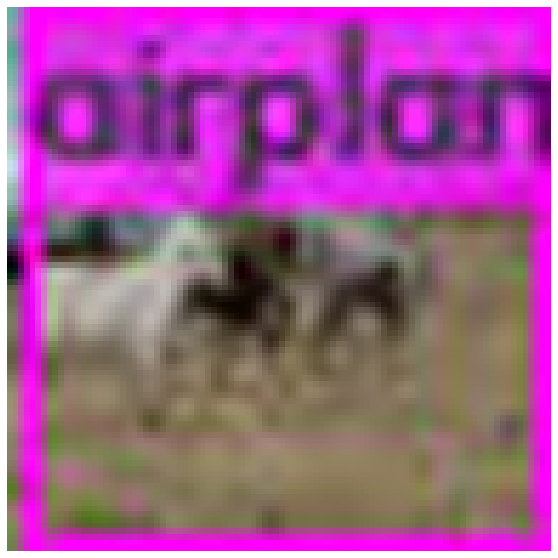

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_40000.weights data/horses_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/horses_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_41000.weights...
 seen 64, trained: 2624 K-images (41 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/horses_small.jpg: Predicted in 14.289000 milli-seconds.
airplane: 61%
deer: 30%


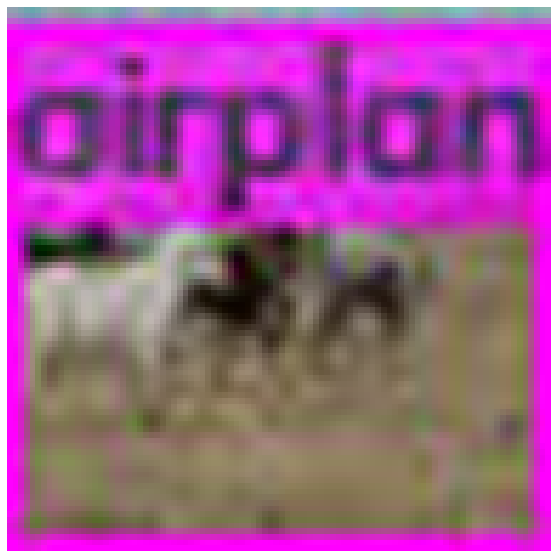

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_41000.weights data/horses_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/horse_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/horses_small.jpg: Predicted in 15.895000 milli-seconds.
horse: 34%


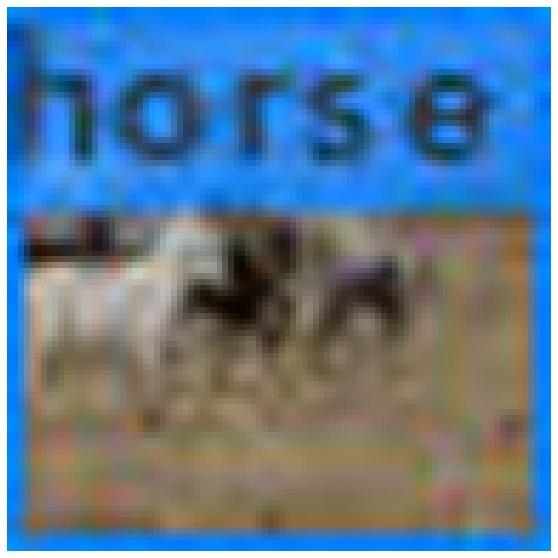

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_42000.weights data/horses_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/horse_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 100 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 101 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_43000.weights...
 seen 64, trained: 2752 K-images (43 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/horses_small.jpg: Predicted in 14.998000 milli-seconds.


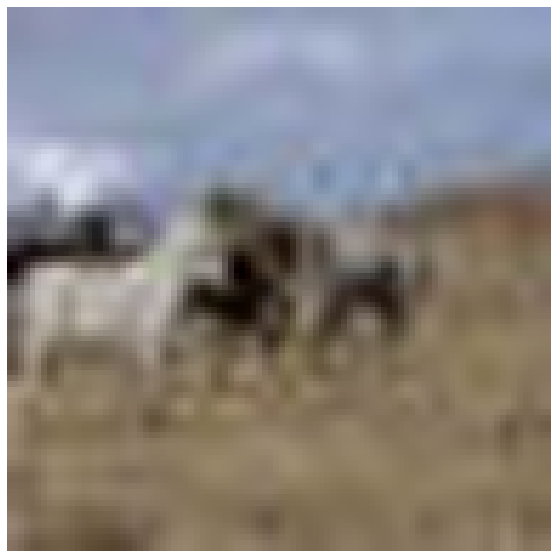

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_43000.weights data/horses_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/horse_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_44000.weights...
 seen 64, trained: 2816 K-images (44 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/horses_small.jpg: Predicted in 15.011000 milli-seconds.
airplane: 50%
deer: 36%


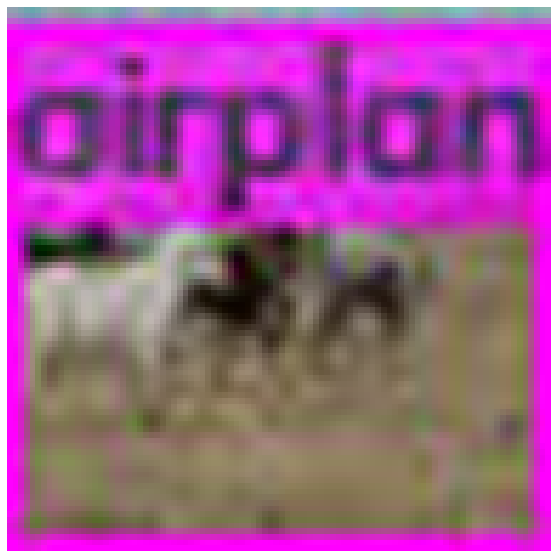

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_44000.weights data/horses_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/horse_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/horses_small.jpg: Predicted in 15.202000 milli-seconds.


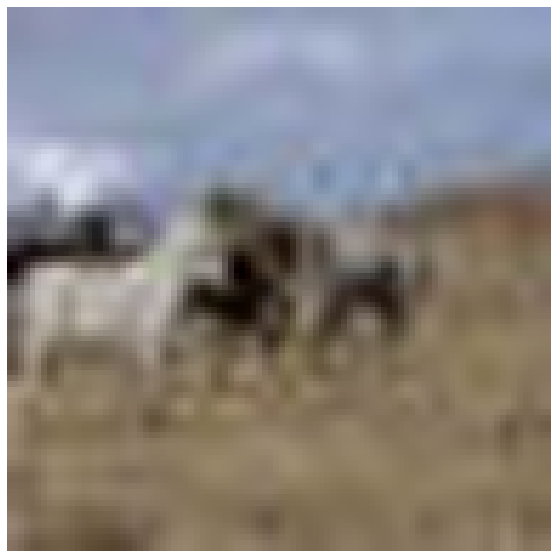

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_45000.weights data/horses_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/horse_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 100 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 101 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_46000.weights...
 seen 64, trained: 2944 K-images (46 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/horses_small.jpg: Predicted in 15.569000 milli-seconds.
airplane: 33%


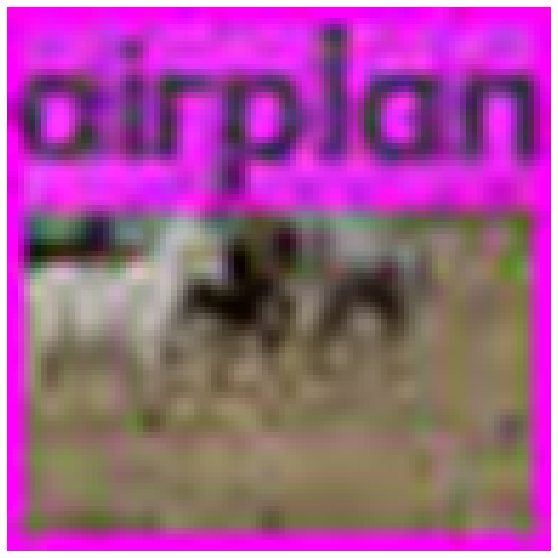

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_46000.weights data/horses_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/horse_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_47000.weights...
 seen 64, trained: 3008 K-images (47 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/horses_small.jpg: Predicted in 15.184000 milli-seconds.
airplane: 50%
deer: 32%


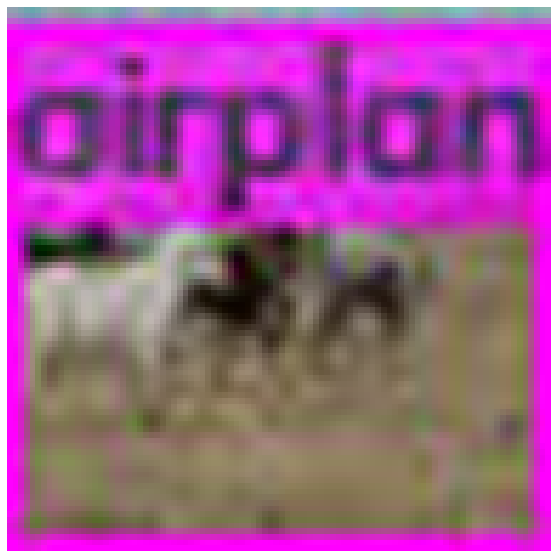

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_47000.weights data/horses_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/horse_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/horses_small.jpg: Predicted in 15.015000 milli-seconds.
airplane: 46%
deer: 35%


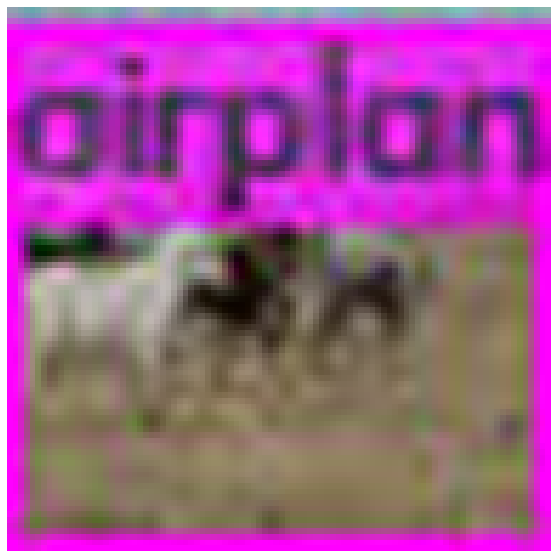

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_48000.weights data/horses_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/horse_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 100 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 101 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_49000.weights...
 seen 64, trained: 3136 K-images (49 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/horses_small.jpg: Predicted in 15.467000 milli-seconds.


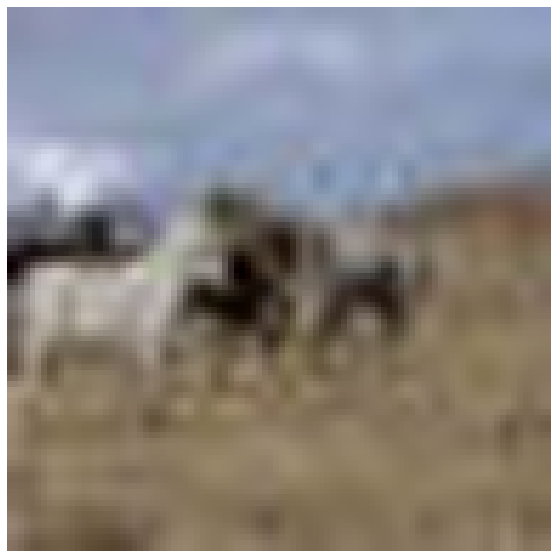

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_49000.weights data/horses_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/horse_small_new.jpg

### Agata-barco

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/Agata-barco.jpg: Predicted in 14.117000 milli-seconds.
frog: 38%


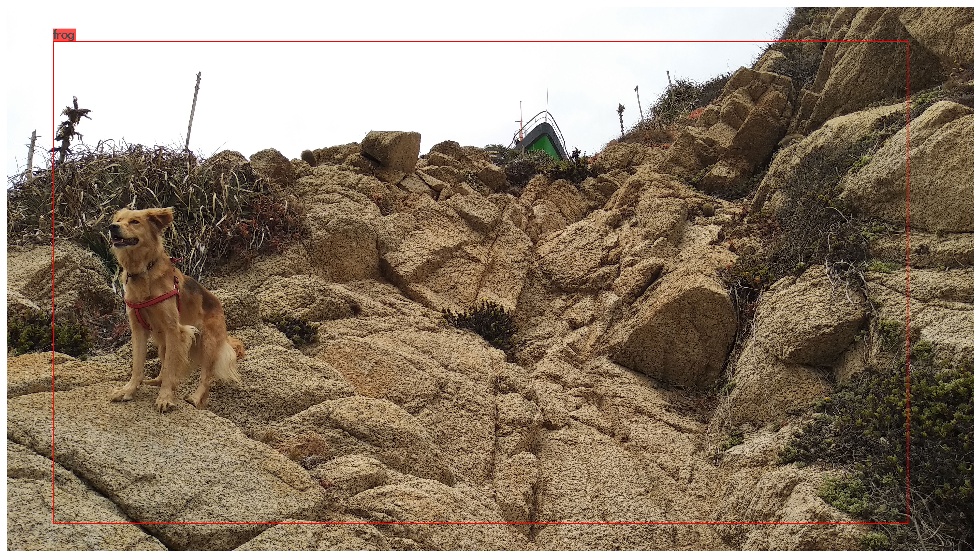

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_40000.weights data/Agata-barco.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-barco_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/Agata-barco.jpg: Predicted in 14.001000 milli-seconds.
frog: 95%


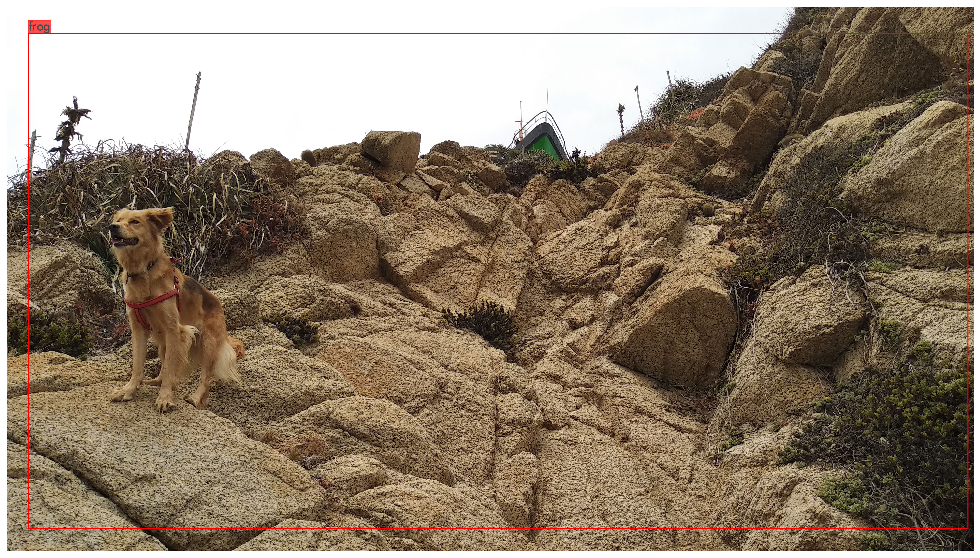

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_41000.weights data/Agata-barco.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-barco_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/Agata-barco.jpg: Predicted in 14.921000 milli-seconds.
frog: 42%


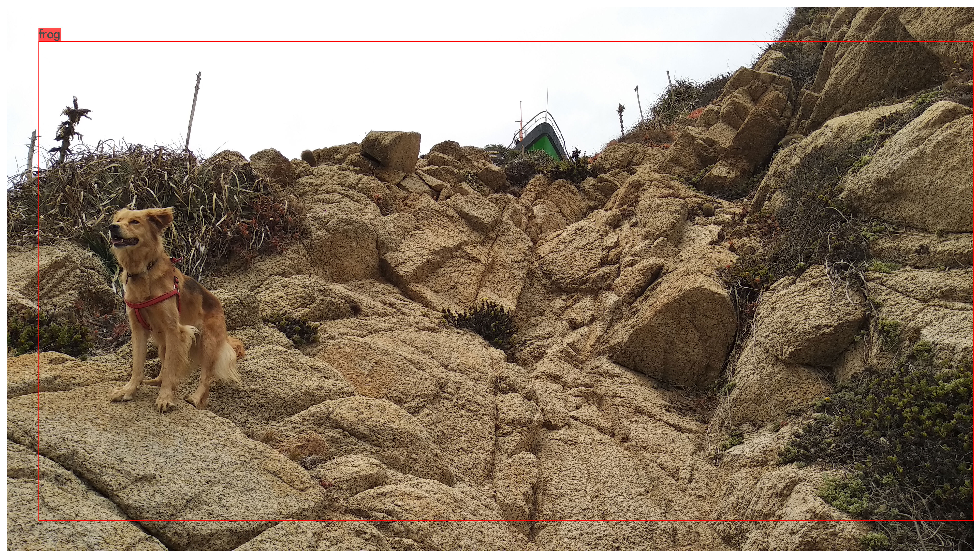

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_42000.weights data/Agata-barco.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-barco_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/Agata-barco.jpg: Predicted in 15.129000 milli-seconds.


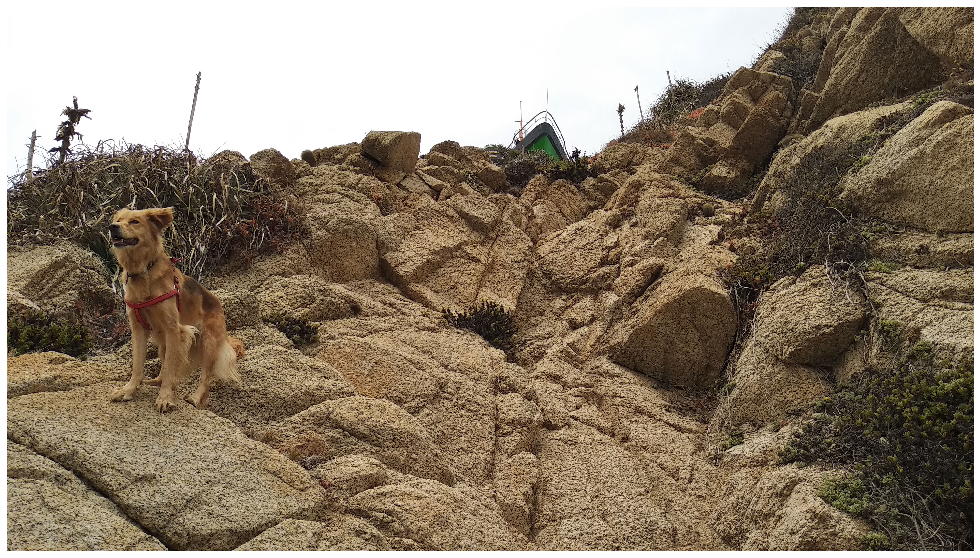

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_43000.weights data/Agata-barco.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-barco_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/Agata-barco.jpg: Predicted in 15.424000 milli-seconds.
frog: 89%


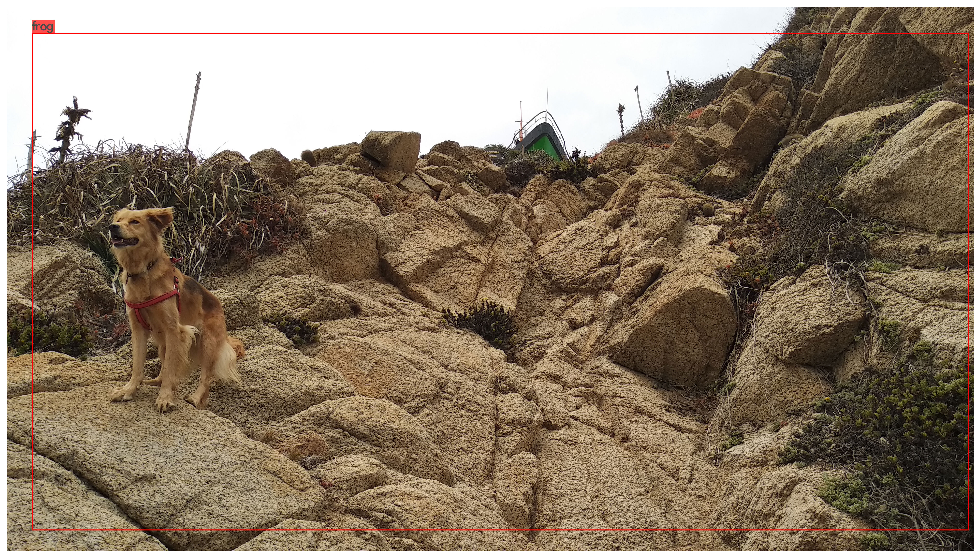

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_44000.weights data/Agata-barco.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-barco_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_45000.weights...
 seen 64, trained: 2880 K-images (45 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/Agata-barco.jpg: Predicted in 15.276000 milli-seconds.


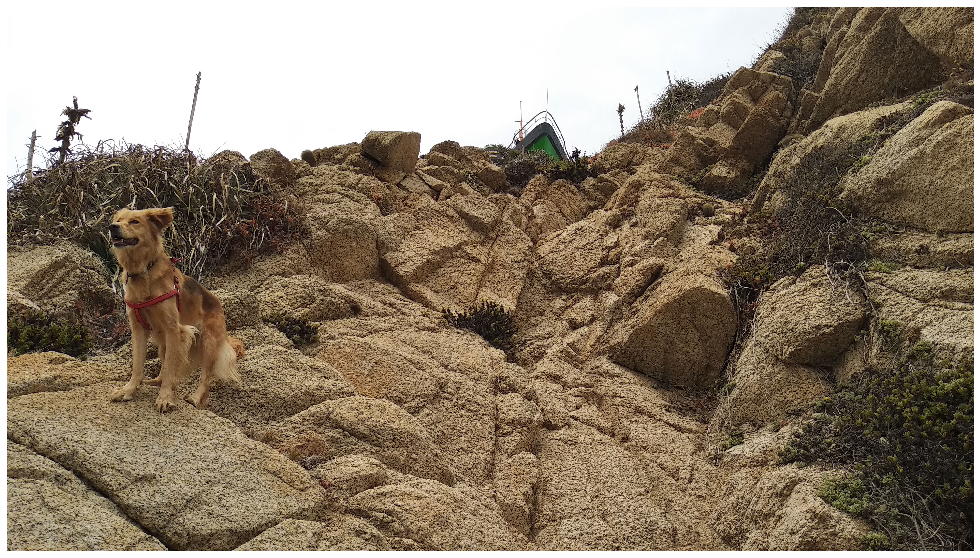

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_45000.weights data/Agata-barco.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-barco_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/Agata-barco.jpg: Predicted in 15.467000 milli-seconds.


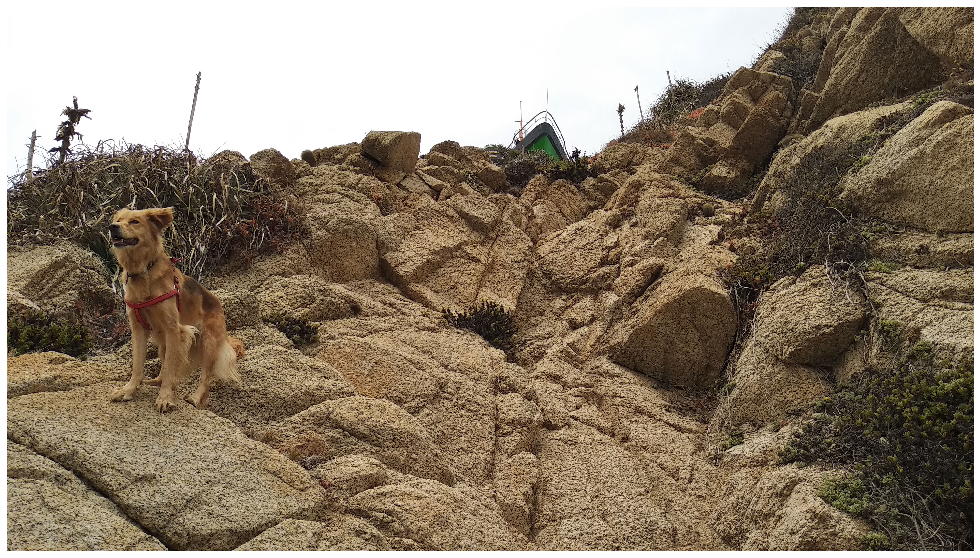

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_46000.weights data/Agata-barco.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-barco_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_47000.weights...
 seen 64, trained: 3008 K-images (47 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/Agata-barco.jpg: Predicted in 14.748000 milli-seconds.
frog: 85%


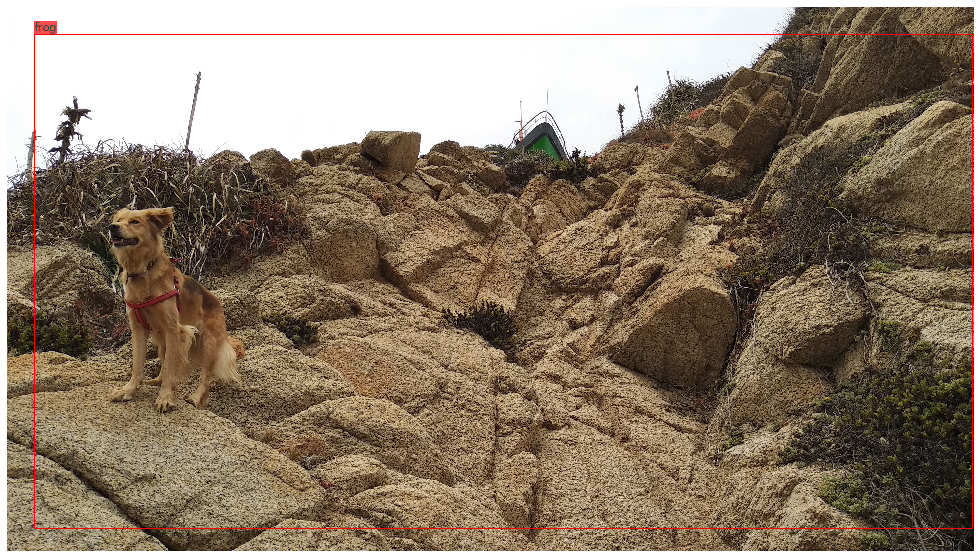

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_47000.weights data/Agata-barco.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-barco_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 100 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 101 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_48000.weights...
 seen 64, trained: 3072 K-images (48 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/Agata-barco.jpg: Predicted in 15.406000 milli-seconds.
frog: 87%


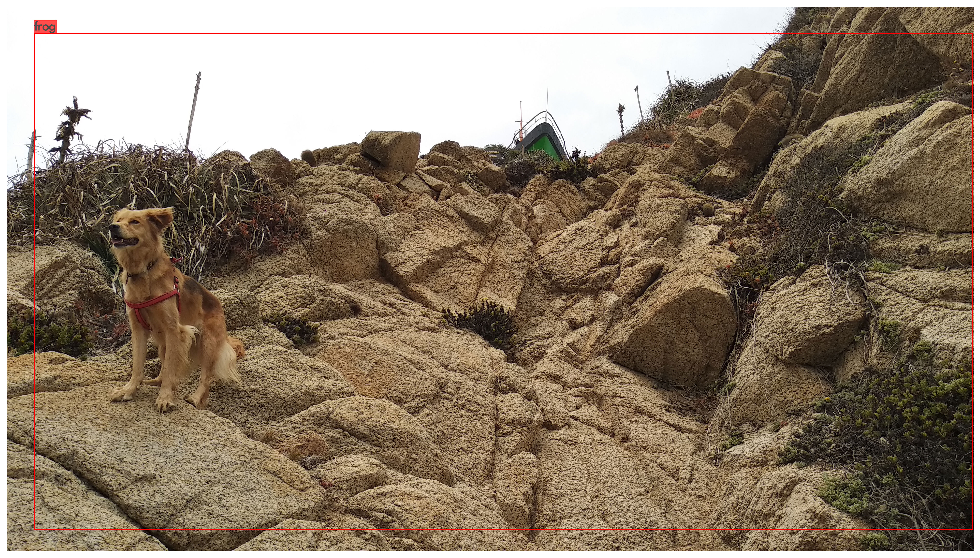

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_48000.weights data/Agata-barco.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-barco_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_49000.weights...
 seen 64, trained: 3136 K-images (49 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/Agata-barco.jpg: Predicted in 15.563000 milli-seconds.


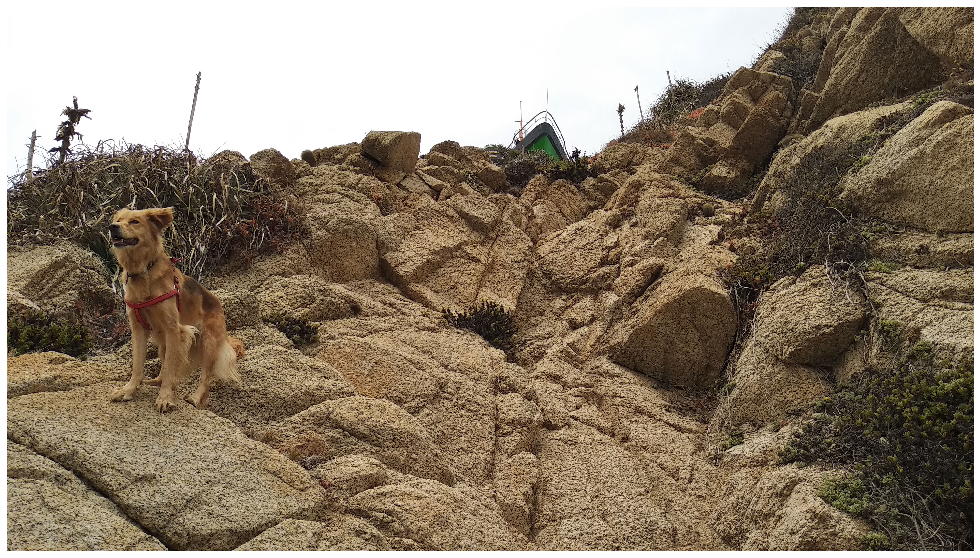

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_49000.weights data/Agata-barco.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-barco_new.jpg

### Agata-carpa

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Loading weights from backup/yolov3_custom_last.weights...
 seen 64, trained: 3200 K-images (50 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/Agata-carpa.jpg: Predicted in 14.203000 milli-seconds.


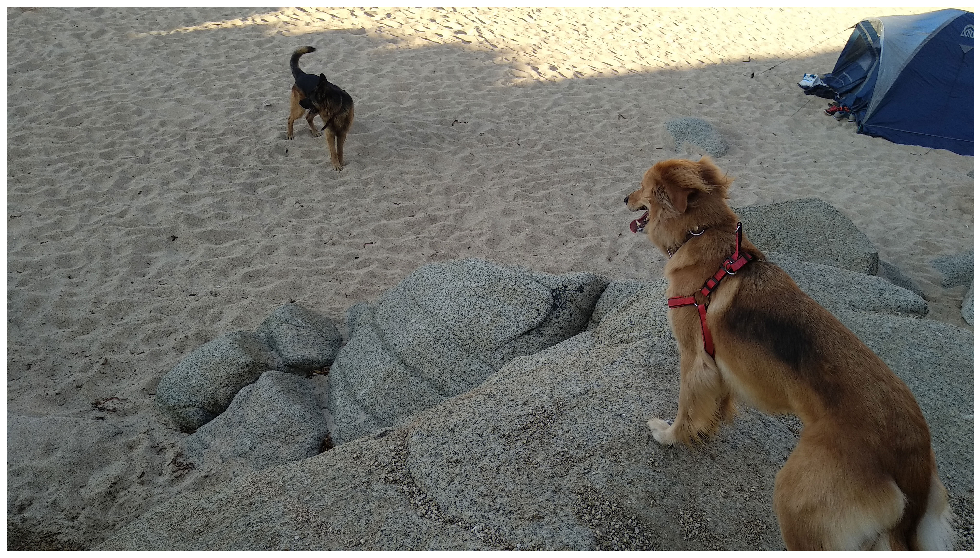

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_last.weights data/Agata-carpa.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-carpa_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_last.weights...
 seen 64, trained: 3200 K-images (50 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/Agata-ojo.jpg: Predicted in 14.200000 milli-seconds.


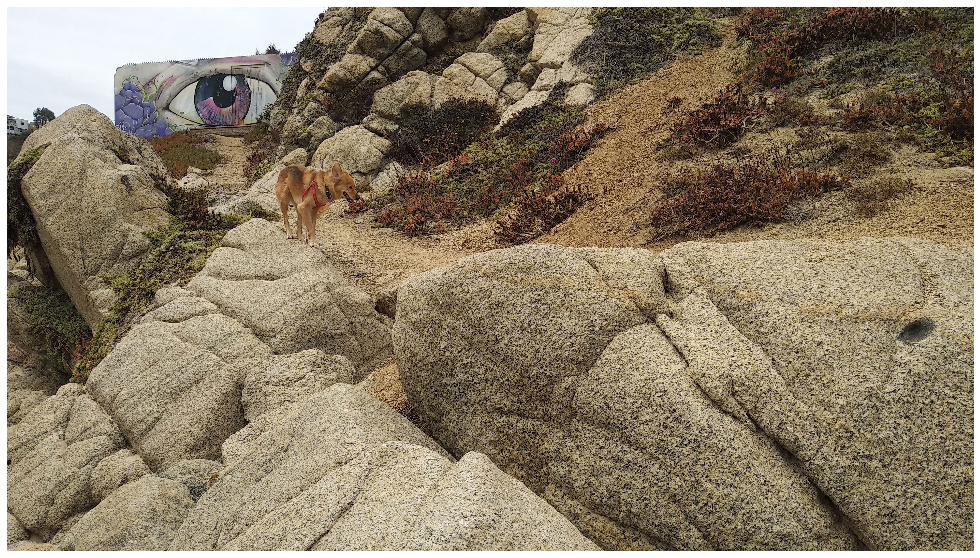

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_last.weights data/Agata-ojo.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/Agata-ojo_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_last.weights...
 seen 64, trained: 3200 K-images (50 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/arbusto.jpg: Predicted in 15.598000 milli-seconds.
frog: 51%


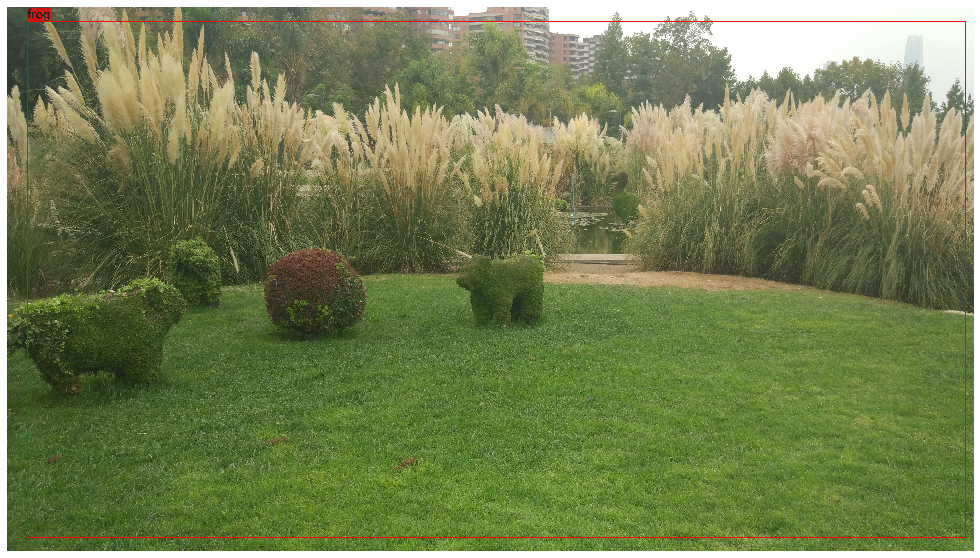

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_last.weights data/arbusto.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/arbusto_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/arbusto-2.jpg: Predicted in 15.620000 milli-seconds.


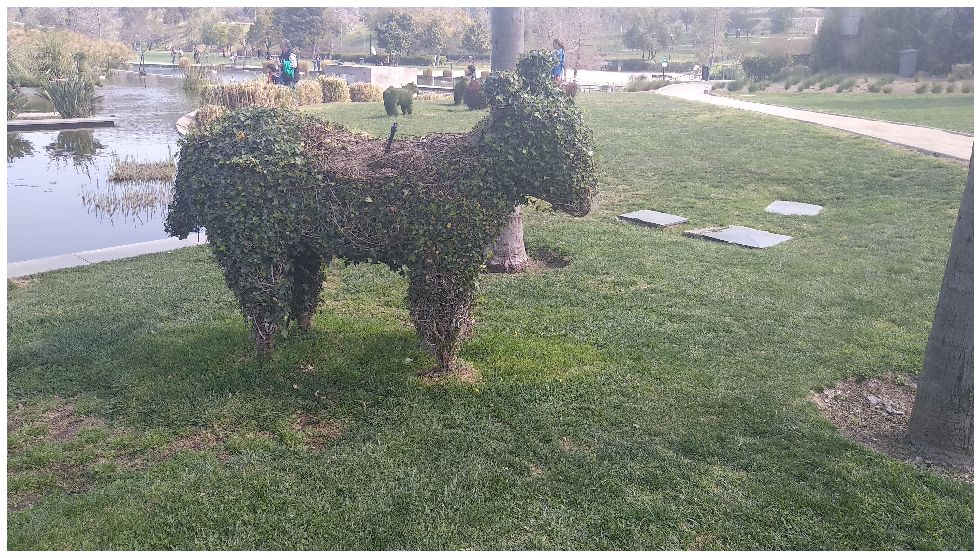

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_last.weights data/arbusto-2.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/arbusto-2_new.jpg

### ave

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/ave_small.jpg: Predicted in 15.616000 milli-seconds.
bird: 50%
frog: 34%


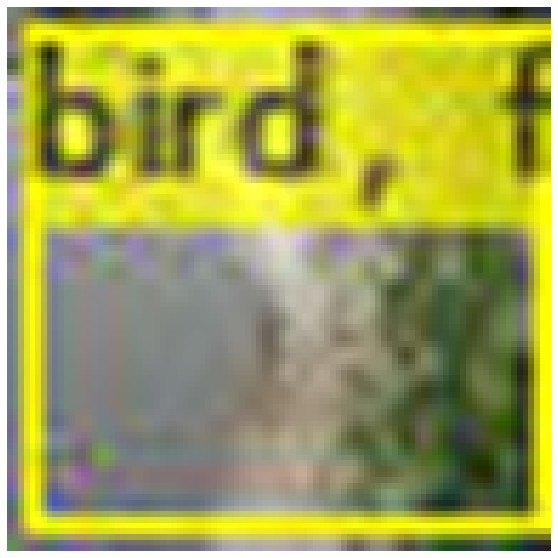

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_40000.weights data/ave_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/ave_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 100 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 101 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_41000.weights...
 seen 64, trained: 2624 K-images (41 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/ave_small.jpg: Predicted in 14.287000 milli-seconds.
bird: 92%


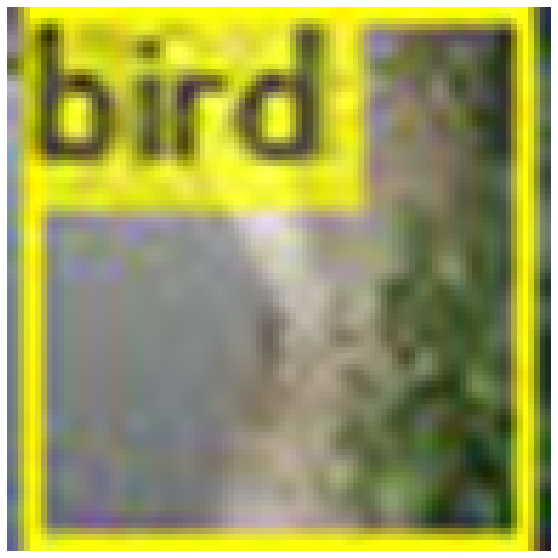

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_41000.weights data/ave_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/ave_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_42000.weights...
 seen 64, trained: 2688 K-images (42 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/ave_small.jpg: Predicted in 15.534000 milli-seconds.
bird: 78%


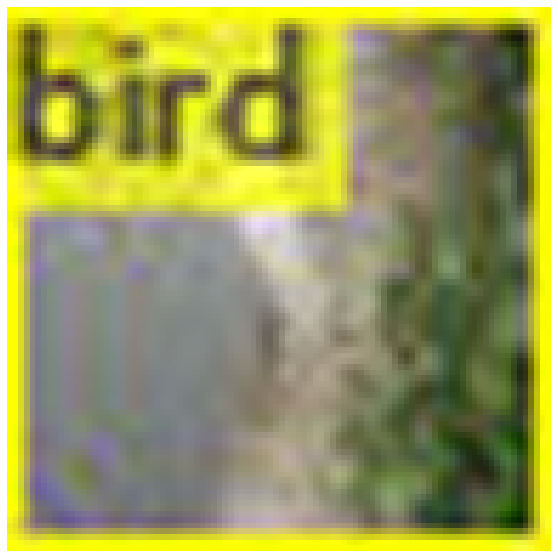

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_42000.weights data/ave_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/ave_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/ave_small.jpg: Predicted in 15.455000 milli-seconds.
bird: 48%


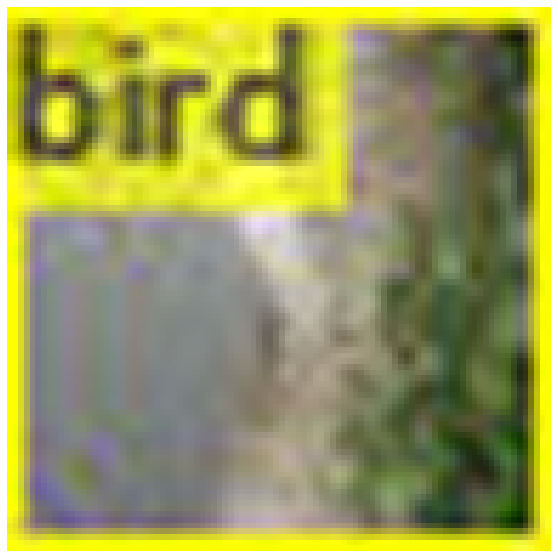

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_43000.weights data/ave_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/ave_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/ave_small.jpg: Predicted in 13.626000 milli-seconds.
bird: 90%


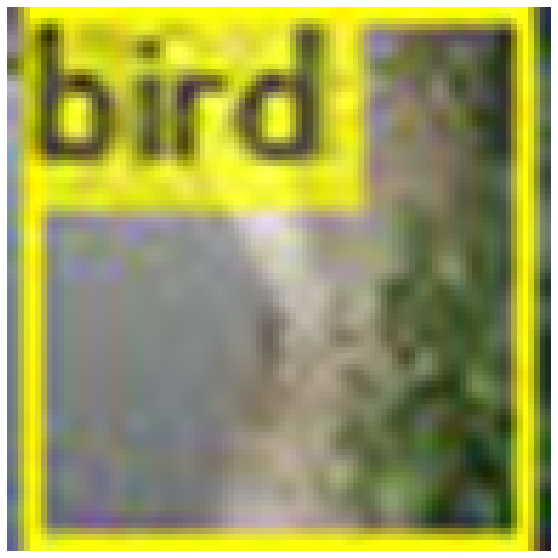

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_44000.weights data/ave_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/ave_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/ave_small.jpg: Predicted in 13.825000 milli-seconds.
bird: 45%


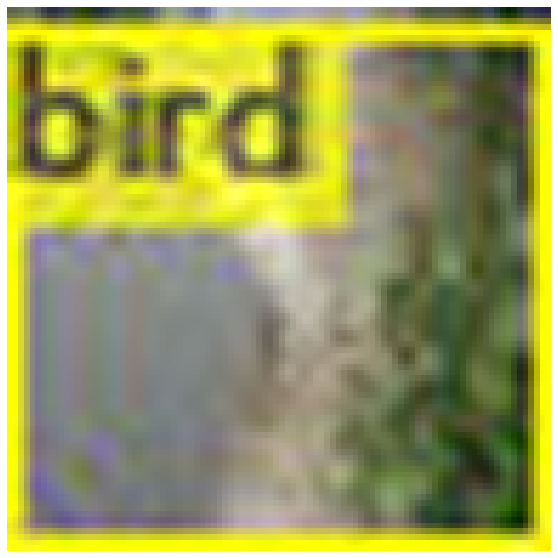

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_45000.weights data/ave_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/ave_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_46000.weights...
 seen 64, trained: 2944 K-images (46 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/ave_small.jpg: Predicted in 13.883000 milli-seconds.
bird: 68%


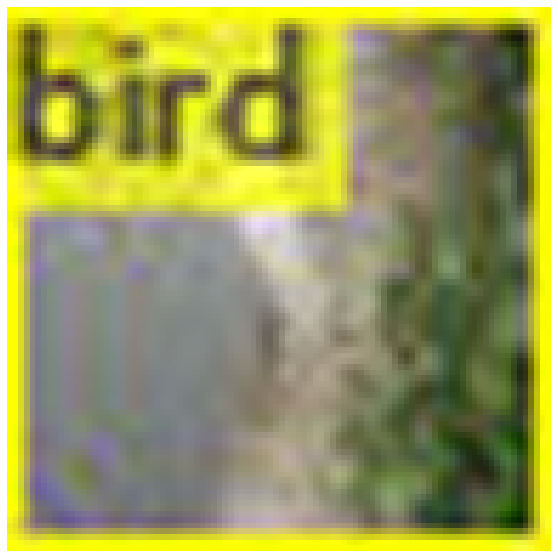

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_46000.weights data/ave_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/ave_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/ave_small.jpg: Predicted in 14.960000 milli-seconds.
bird: 90%


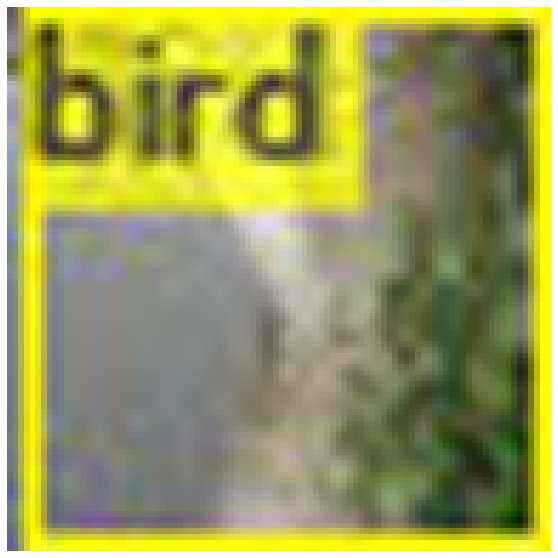

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_47000.weights data/ave_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/ave_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/ave_small.jpg: Predicted in 15.069000 milli-seconds.
bird: 90%


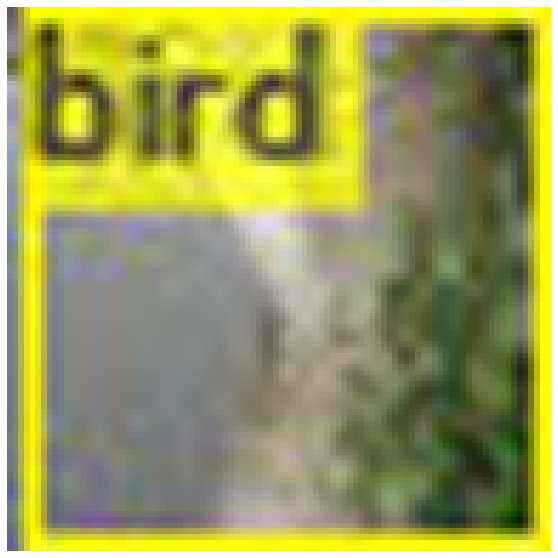

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_48000.weights data/ave_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/ave_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/ave_small.jpg: Predicted in 13.857000 milli-seconds.
bird: 65%


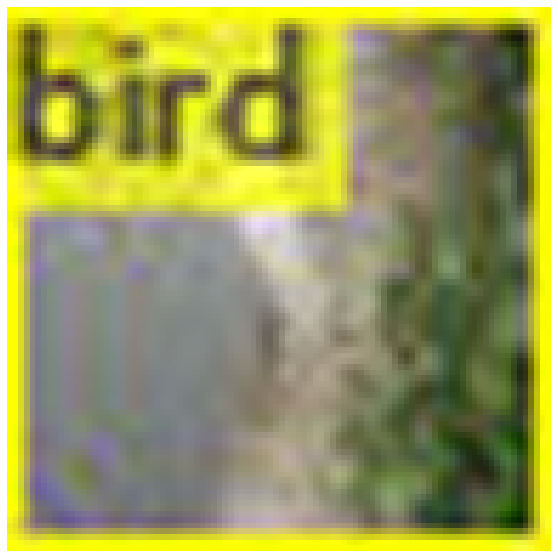

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_49000.weights data/ave_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/ave_small_new.jpg

### cisne-pez

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/cisne-pez.jpg: Predicted in 15.497000 milli-seconds.


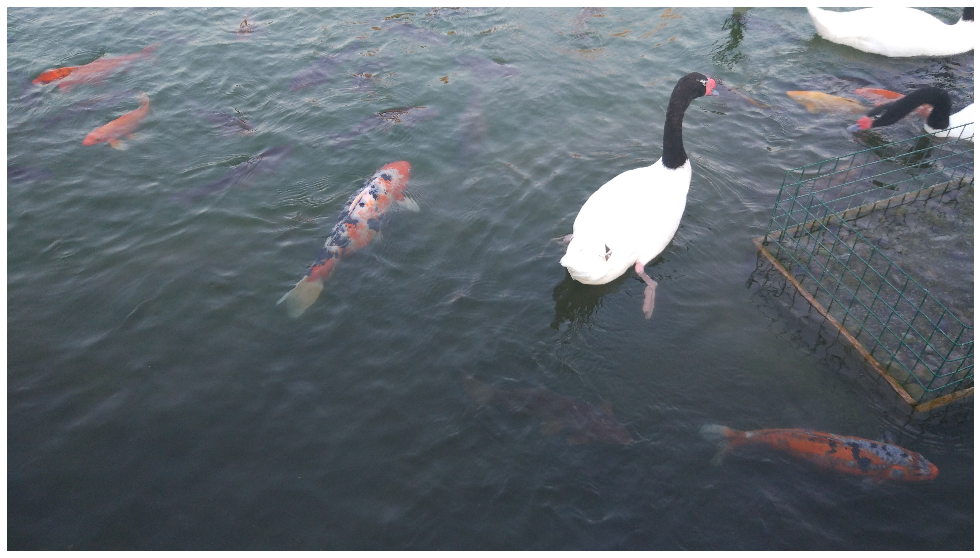

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_last.weights data/cisne-pez.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/cisne-pez_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/estrella-de-mar.jpg: Predicted in 14.855000 milli-seconds.


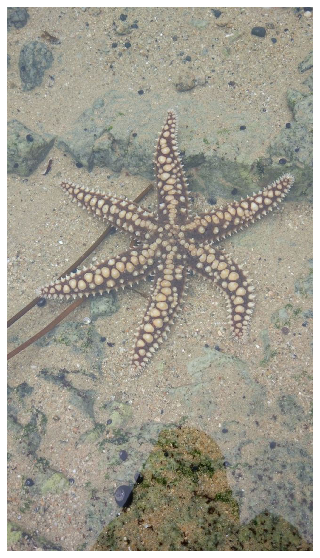

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_last.weights data/estrella-de-mar.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/estrella-de-mar_new.jpg

### flamencos

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/flamencos_small.jpg: Predicted in 14.927000 milli-seconds.
frog: 58%


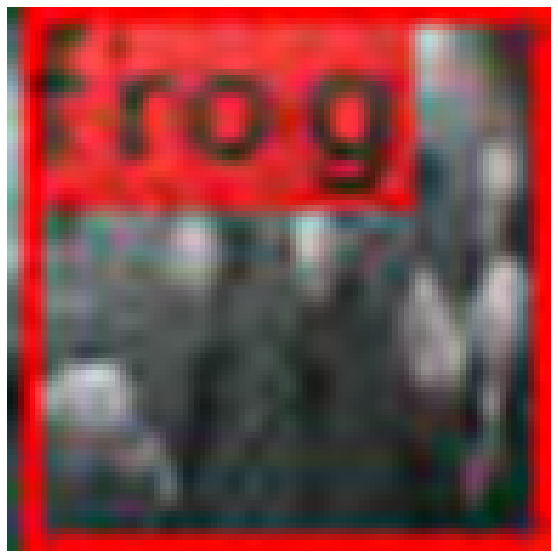

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_40000.weights data/flamencos_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/flamencos_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_41000.weights...
 seen 64, trained: 2624 K-images (41 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/flamencos_small.jpg: Predicted in 15.418000 milli-seconds.
frog: 61%


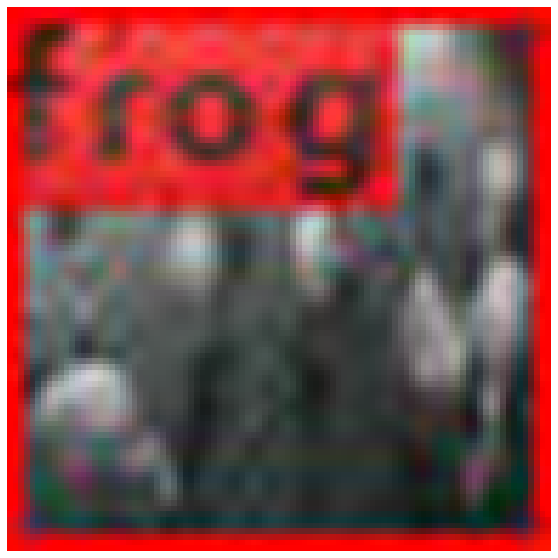

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_41000.weights data/flamencos_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/flamencos_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_42000.weights...
 seen 64, trained: 2688 K-images (42 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/flamencos_small.jpg: Predicted in 15.286000 milli-seconds.
frog: 51%


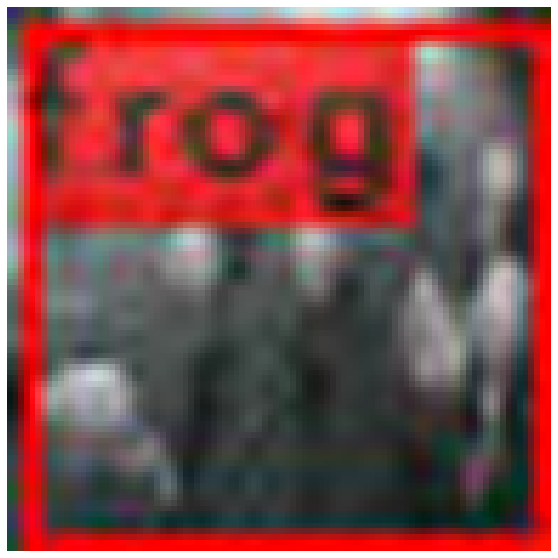

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_42000.weights data/flamencos_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/flamencos_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/flamencos_small.jpg: Predicted in 15.321000 milli-seconds.


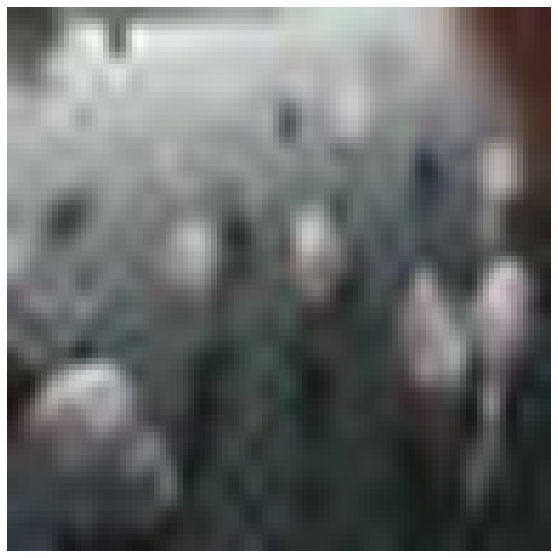

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_43000.weights data/flamencos_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/flamencos_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/flamencos_small.jpg: Predicted in 15.928000 milli-seconds.
frog: 78%


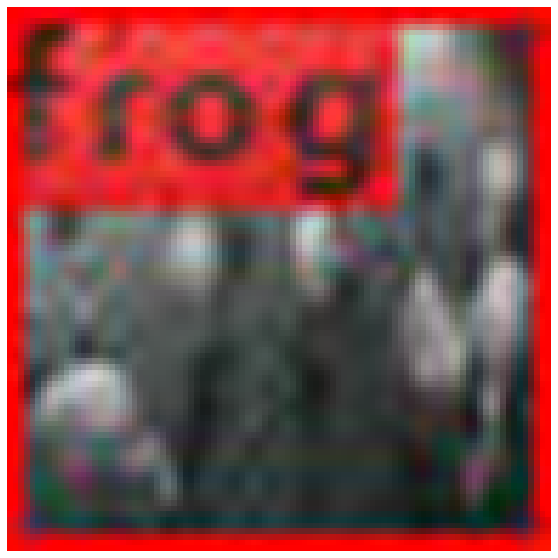

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_44000.weights data/flamencos_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/flamencos_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_45000.weights...
 seen 64, trained: 2880 K-images (45 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/flamencos_small.jpg: Predicted in 14.909000 milli-seconds.


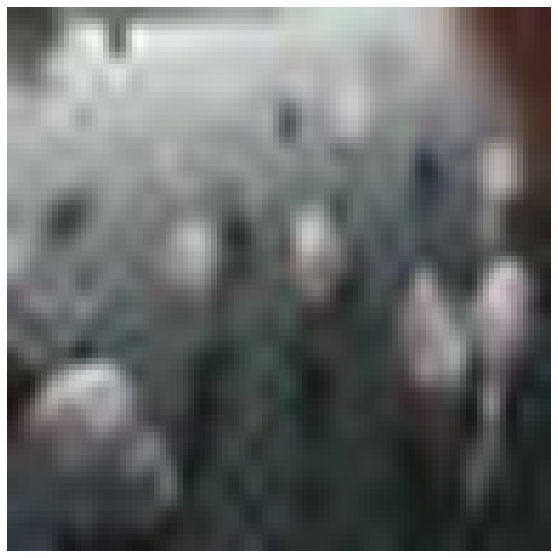

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_45000.weights data/flamencos_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/flamencos_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/flamencos_small.jpg: Predicted in 15.517000 milli-seconds.
frog: 34%


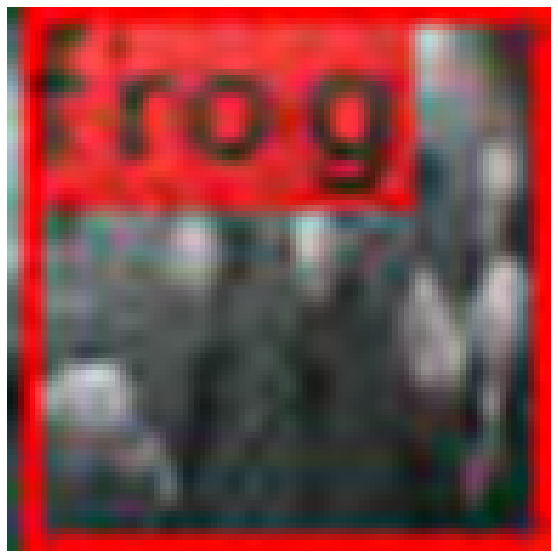

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_46000.weights data/flamencos_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/flamencos_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 100 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 101 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_47000.weights...
 seen 64, trained: 3008 K-images (47 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/flamencos_small.jpg: Predicted in 14.804000 milli-seconds.
frog: 75%


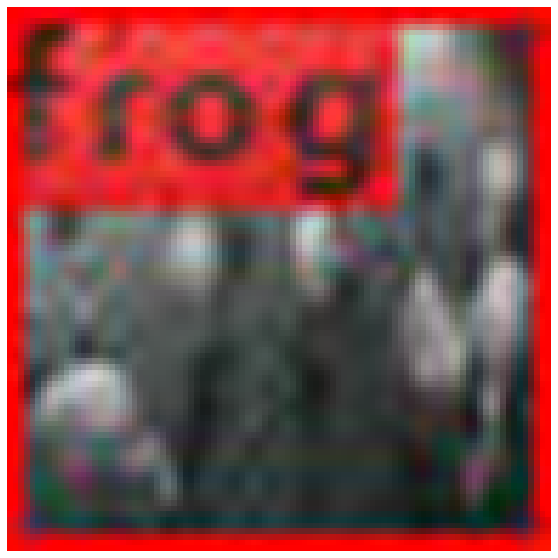

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_47000.weights data/flamencos_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/flamencos_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/flamencos_small.jpg: Predicted in 15.233000 milli-seconds.
frog: 78%


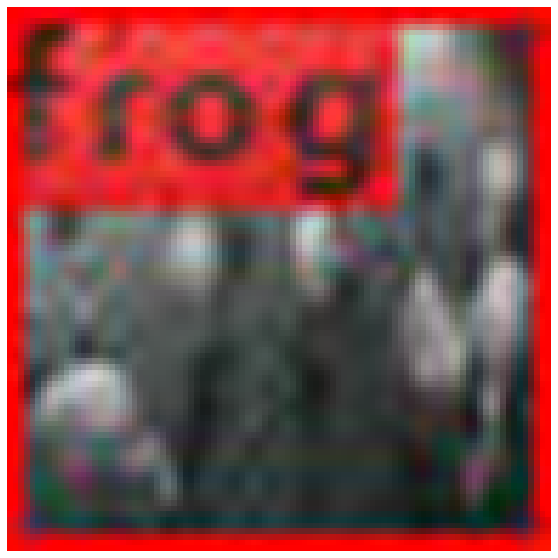

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_48000.weights data/flamencos_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/flamencos_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_49000.weights...
 seen 64, trained: 3136 K-images (49 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/flamencos_small.jpg: Predicted in 14.495000 milli-seconds.
frog: 31%


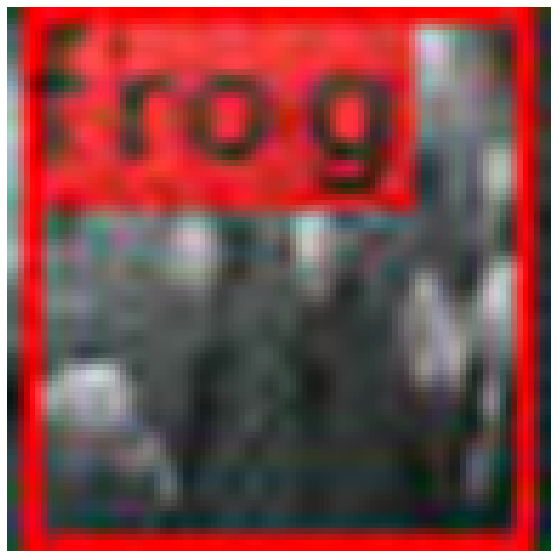

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_49000.weights data/flamencos_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/flamencos_small_new.jpg

### foca

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/foca.jpg: Predicted in 15.785000 milli-seconds.


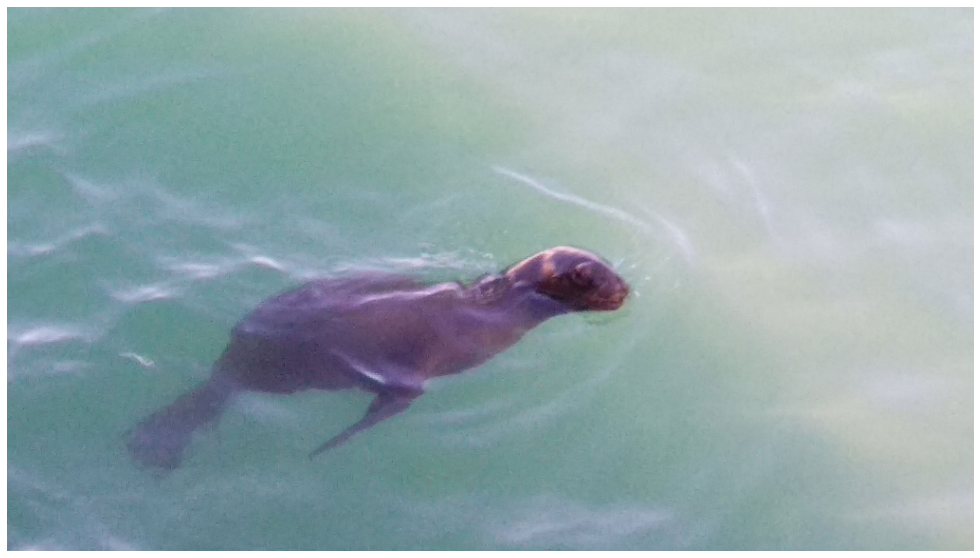

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_last.weights data/foca.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/foca_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 100 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 101 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_last.weights...
 seen 64, trained: 3200 K-images (50 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/gato.jpg: Predicted in 14.936000 milli-seconds.


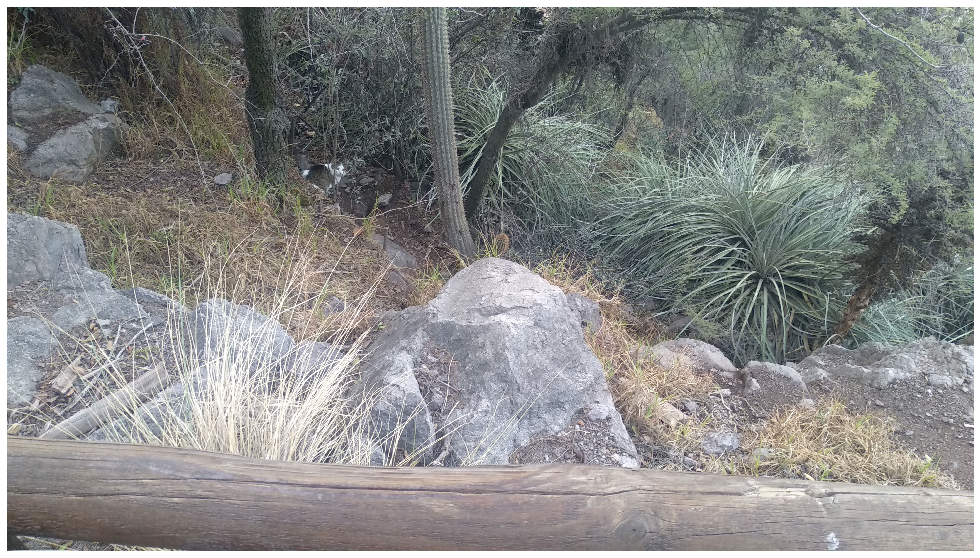

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_last.weights data/gato.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/gato_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/gente-lejana.jpg: Predicted in 15.023000 milli-seconds.


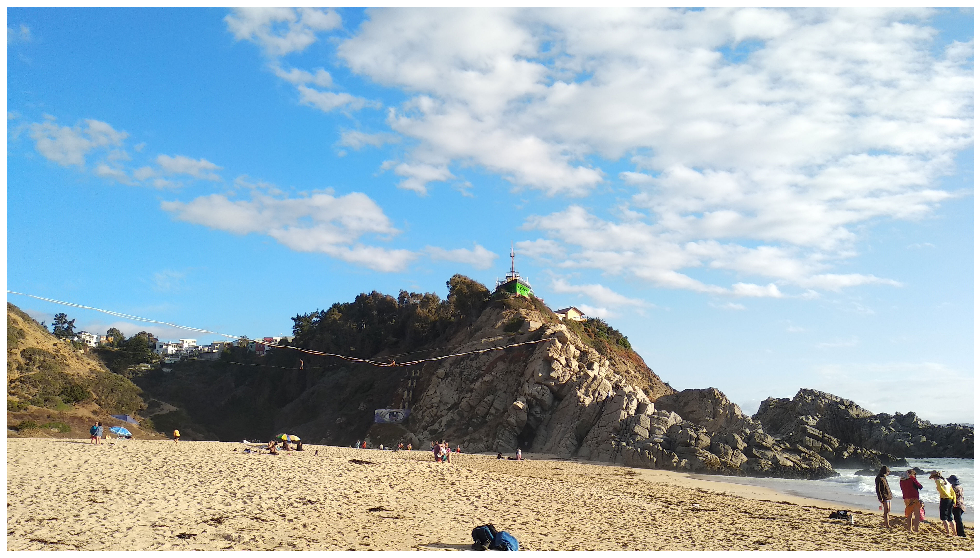

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_last.weights data/gente-lejana.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/gente-lejana_new.jpg

### gorrion

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/gorrion_small.jpg: Predicted in 15.340000 milli-seconds.
frog: 79%


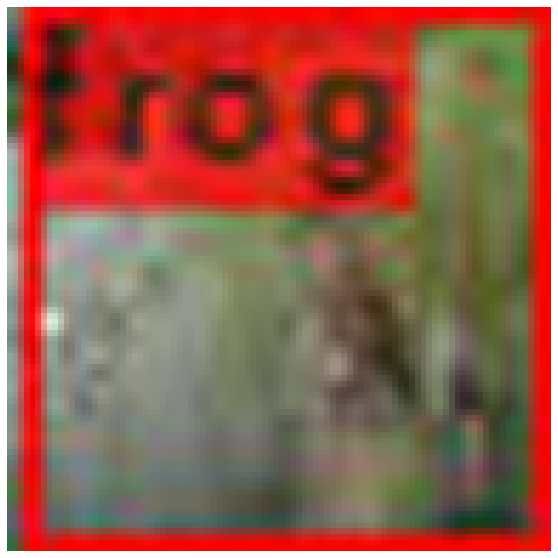

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_40000.weights data/gorrion_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/gorrion_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/gorrion_small.jpg: Predicted in 15.731000 milli-seconds.
deer: 40%
bird: 31%


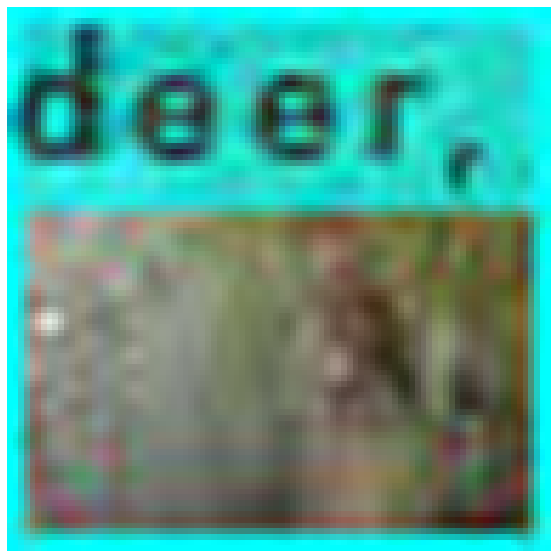

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_41000.weights data/gorrion_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/gorrion_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/gorrion_small.jpg: Predicted in 14.439000 milli-seconds.
frog: 71%


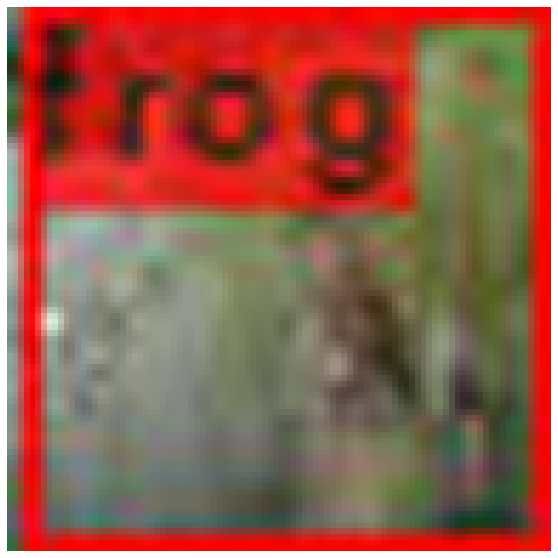

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_42000.weights data/gorrion_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/gorrion_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/gorrion_small.jpg: Predicted in 15.041000 milli-seconds.
frog: 59%


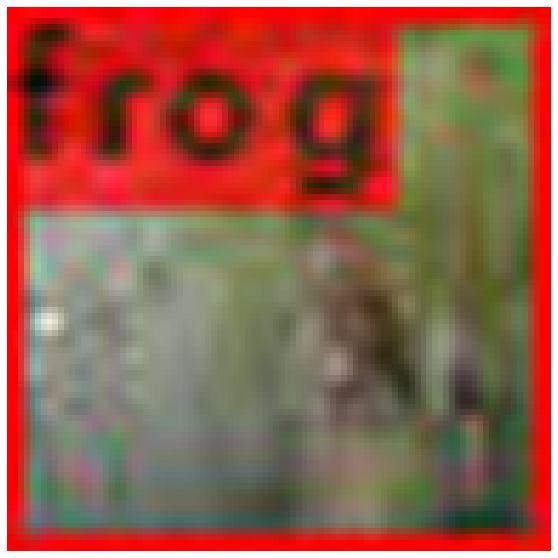

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_43000.weights data/gorrion_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/gorrion_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/gorrion_small.jpg: Predicted in 15.416000 milli-seconds.
deer: 61%


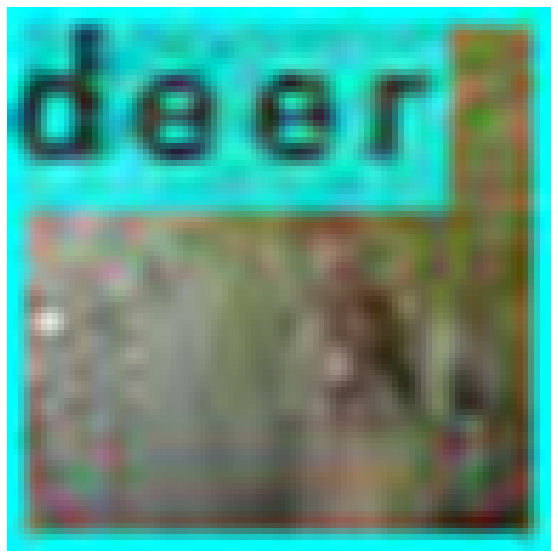

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_44000.weights data/gorrion_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/gorrion_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_45000.weights...
 seen 64, trained: 2880 K-images (45 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/gorrion_small.jpg: Predicted in 14.743000 milli-seconds.
frog: 47%


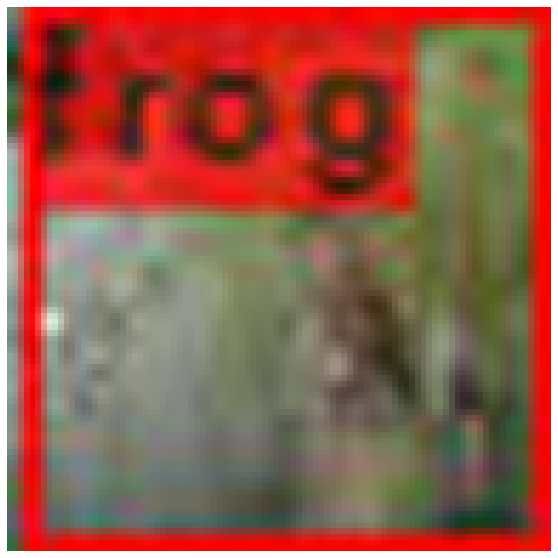

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_45000.weights data/gorrion_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/gorrion_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/gorrion_small.jpg: Predicted in 14.967000 milli-seconds.
frog: 61%


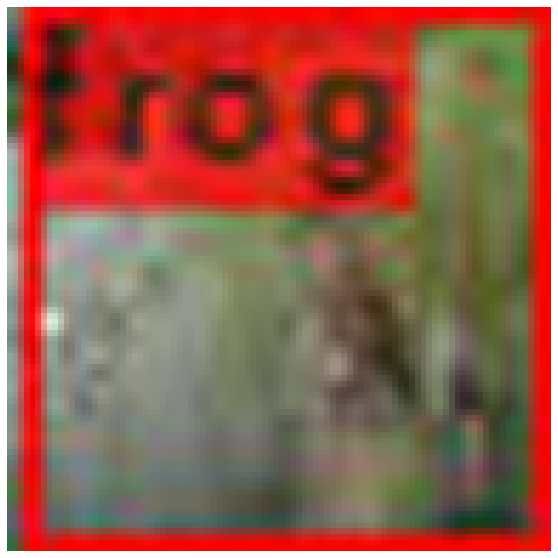

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_46000.weights data/gorrion_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/gorrion_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_47000.weights...
 seen 64, trained: 3008 K-images (47 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/gorrion_small.jpg: Predicted in 15.093000 milli-seconds.
deer: 47%
bird: 33%


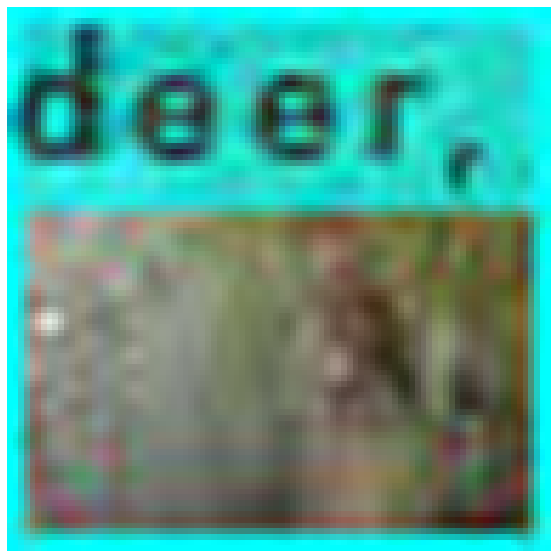

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_47000.weights data/gorrion_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/gorrion_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/gorrion_small.jpg: Predicted in 15.230000 milli-seconds.
deer: 47%
bird: 31%


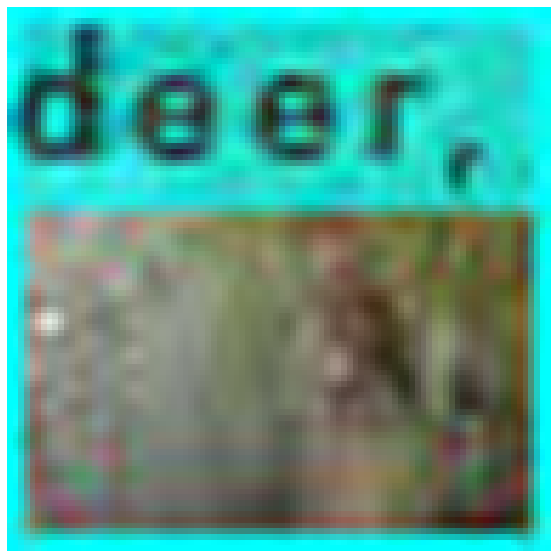

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_48000.weights data/gorrion_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/gorrion_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_49000.weights...
 seen 64, trained: 3136 K-images (49 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/gorrion_small.jpg: Predicted in 15.485000 milli-seconds.
frog: 62%


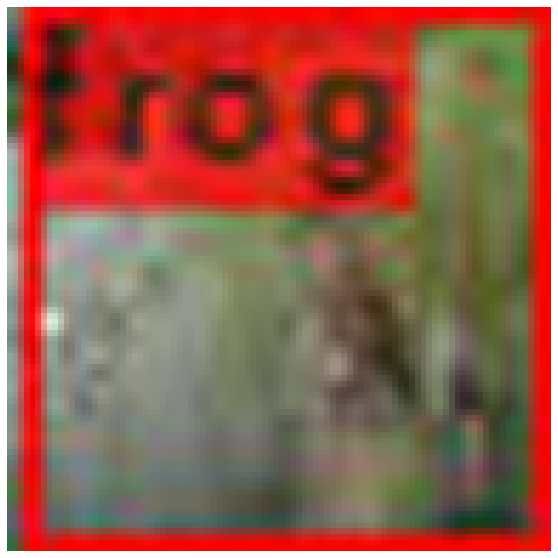

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_49000.weights data/gorrion_small.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/gorrion_small_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_last.weights...
 seen 64, trained: 3200 K-images (50 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/perras-juntas.jpg: Predicted in 14.301000 milli-seconds.
frog: 56%


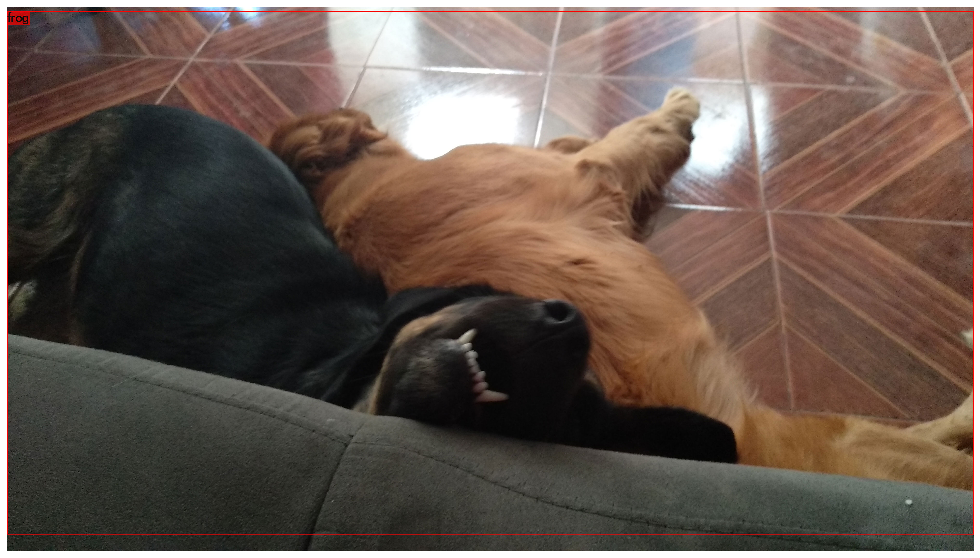

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_last.weights data/perras-juntas.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/perras-juntas_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

 102 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 103 conv    128       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x 128 0.001 BF
 104 conv    256       3 x 3/ 1      4 x   4 x 128 ->    4 x   4 x 256 0.009 BF
 105 conv     45       1 x 1/ 1      4 x   4 x 256 ->    4 x   4 x  45 0.000 BF
 106 yolo
[yolo] params: iou loss: mse (2), iou_norm: 0.75, cls_norm: 1.00, scale_x_y: 1.00
Total BFLOPS 0.387 
avg_outputs = 3716 
 Allocate additional workspace_size = 52.43 MB 
Loading weights from backup/yolov3_custom_last.weights...
 seen 64, trained: 3200 K-images (50 Kilo-batches_64) 
Done! Loaded 107 layers from weights-file 
data/perras-juntas-2.jpg: Predicted in 14.989000 milli-seconds.
frog: 67%


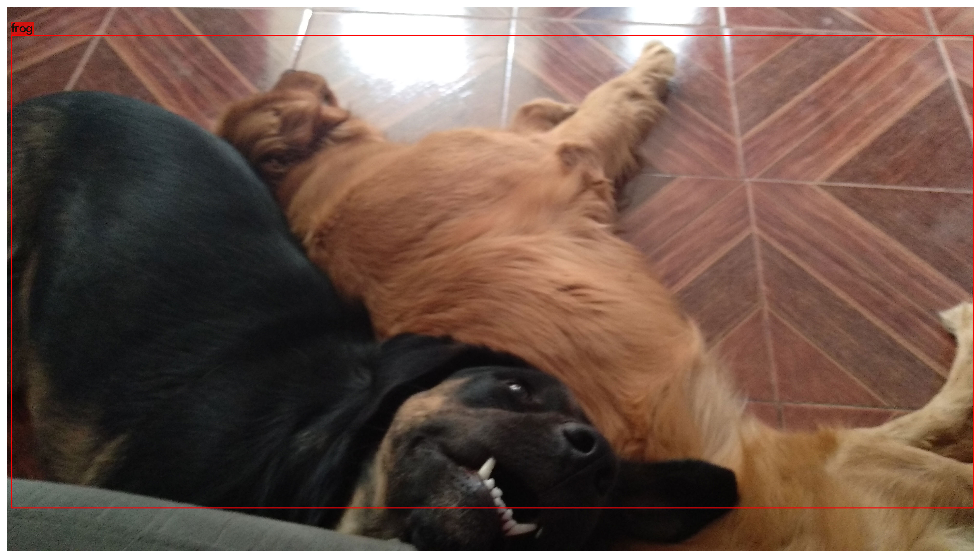

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_last.weights data/perras-juntas-2.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/perras-juntas-2_new.jpg

 CUDA-version: 10010 (10020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 4.3.0
names: Using default 'data/names.list'
 0 : compute_capability = 610, cudnn_half = 0, GPU: GeForce GTX 1060 with Max-Q Design 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1     32 x  32 x   3 ->   32 x  32 x  32 0.002 BF
   1 conv     64       3 x 3/ 2     32 x  32 x  32 ->   16 x  16 x  64 0.009 BF
   2 conv     32       1 x 1/ 1     16 x  16 x  64 ->   16 x  16 x  32 0.001 BF
   3 conv     64       3 x 3/ 1     16 x  16 x  32 ->   16 x  16 x  64 0.009 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs:  16 x  16 x  64 0.000 BF
   5 conv    128       3 x 3/ 2     16 x  16 x  64 ->    8 x   8 x 128 0.009 BF
   6 conv     64       1 x 1/ 1      8 x   8 x 128 ->    8 x   8 x  64 0.001 BF
   7 conv    128       3 x 3/ 1      8 x   8 x  64 ->    8 x   8 x 128 0.009 BF
   8 Sho

Done! Loaded 107 layers from weights-file 
data/rana-camuflada.jpg: Predicted in 14.625000 milli-seconds.


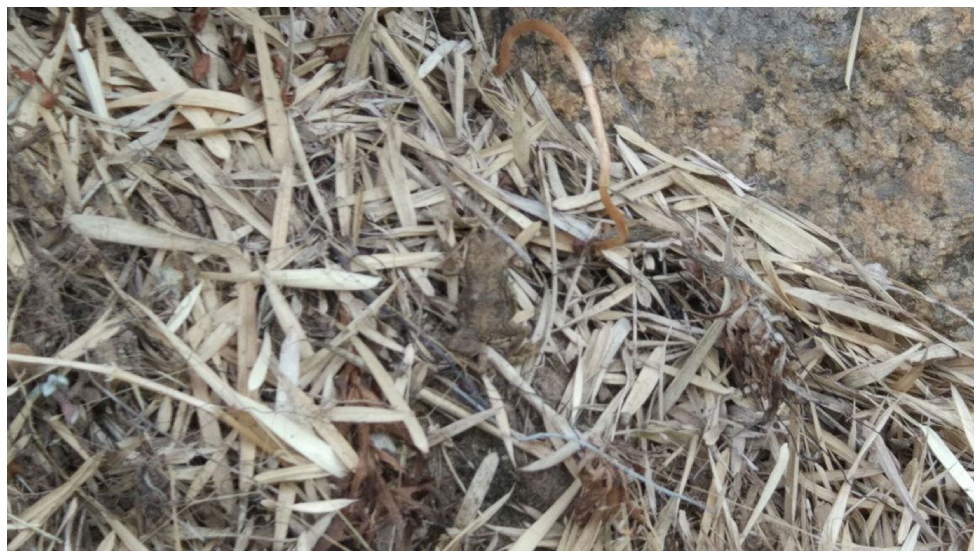

In [0]:
!./darknet detector test cfg/cifar.data cfg/yolov3_custom.cfg backup/yolov3_custom_last.weights data/rana-camuflada.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/rana-camuflada_new.jpg

# For Colab

In [0]:
!./darknet detector test data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights ../../Respaldo/Xiaomi\ MI\ A1/Places/IMG-20180204-WA0005.jpg -thresh 0.3
imShow('predictions.jpg')

!cp predictions.jpg backup/Agata-barco_New.jpg

In [0]:
!./darknet detector test data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights ../../Respaldo/Xiaomi\ MI\ A1/Places/IMG_20190107_194303.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/IMG_20190107_194303-new.jpg

In [0]:
!./darknet detector test data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights ../../Respaldo/Xiaomi\ MI\ A1/Places/IMG_20190908_143909.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/IMG_20190908_143909-new.jpg

In [0]:
!./darknet detector test data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights ../../Respaldo/Xiaomi\ MI\ A1/Places/IMG_20190713_130404.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/IMG_20190713_130404-new.jpg

In [0]:
!./darknet detector test data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights ../../Respaldo/Xiaomi\ MI\ A1/Places/IMG_20190109_130739.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/IMG_20190109_130739-new.jpg

In [0]:
!./darknet detector test data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights ../../Respaldo/Xiaomi\ MI\ A1/Miscellaneous/IMG_20181122_153139.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/IMG_20181122_153139-new.jpg

In [0]:
!./darknet detector test data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights ../../Respaldo/Xiaomi\ MI\ A1/Miscellaneous/IMG_20181122_153134.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/IMG_20181122_153134-new.jpg

In [0]:
!./darknet detector test data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights ../../Respaldo/Xiaomi\ MI\ A1/Places/IMG_20190110_172008.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/IMG_20190110_172008-new.jpg

In [0]:
!./darknet detector test data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights ../../Respaldo/Xiaomi\ MI\ A1/Places/IMG_20190107_193737.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/IMG_20190107_193737-new.jpg

In [0]:
!./darknet detector test data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights ../../Respaldo/Xiaomi\ MI\ A1/Places/IMG_20170324_164021.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/IMG_20170324_164021-new.jpg

In [0]:
!./darknet detector test data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights data/person.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/person-new.jpg

In [0]:
!./darknet detector test data/cifar.data cfg/cifar_small.cfg backup/weights/cifar_small_last.weights data/dog.jpg -thresh 0.3
imShow('predictions.jpg')
!cp predictions.jpg backup/dog-new.jpg